In [77]:
from tool import *
def get_stat(sw_mode,sza_L_mode,band_mode):
    _,sza_L=torch.load(root_path+'sza_and_szaL.pth')
    if band_mode=='shortwave':  
        WB_sky_fraction=torch.load("/data/hk/albedo/white_sky_fraction/white_sky_fraction.pth")
    else:
        if band_mode not in ['nir','vis']:
            raise('Error band_mode!')
        WB_sky_fraction=torch.load(f"/data/hk/albedo/white_sky_fraction/white_sky_fraction_{band_mode}.pth")
    landtypes=['landtype'+str(i) for i in range(1,18)]+['snow']
    stat={}
    for month in range(1,13):
        NC=nc.Dataset(root_path+f'information_fill2/month_{month}.nc','r')
        for year in range(2001,2021):
            types_stat_albedo=[]
            types_stat_area=[]
            types_stat_energy=[]
            if sw_mode=='mean':
                sw=torch.load(f"/data/hk/albedo/SW_MERRA2/{month}_SW_1degree_kernel.pth")###
            elif sw_mode=='year':
                sw=torch.load(f"/data/hk/albedo/SW_MERRA2/{year}_{month}_SW_1degree.tif")
            else:
                raise('Error sw_mode')
            for type in landtypes:
                now=datetime.datetime.strptime(f'2001-{month}-1', '%Y-%m-%d')
                month_time=(now+relativedelta(months=1)-now).total_seconds()
                bs=NC.variables[f'albedo_BSA_{band_mode}-{type}'][year-2001]
                ws=NC.variables[f'albedo_WSA_{band_mode}-{type}'][year-2001]
                area_type=NC.variables[f'area-{type}'][year-2001] 
                area_land=NC.variables[f'area-land'][year-2001] 
                wf=WB_sky_fraction[(year-2001)*12+month-1]
                if sza_L_mode=='70':
                    area_type[sza_L[year-2001,month-1]>=1]=np.nan###
                elif sza_L_mode=='85':
                    area_type[sza_L[year-2001,month-1]>=2]=np.nan###
                else:
                    raise('Error sza_L_mode')
                # area=NC.variables['area-grid'][year-2001]
                if band_mode=='shortwave': 
                    types_stat_energy.append((1-(ws*wf+bs*(1-wf))/1000)*area_type*1e6*sw)
                types_stat_albedo.append(((ws*wf+bs*(1-wf))/1000))
                
                types_stat_area.append(area_type)
                                #   (1-(ws*wf+bs*(1-wf))/1000)*area_type*1e6*month_time
                # types_stat.append((ws*wf+bs*(1-wf))*area_type)
            # types_stat=np.stack(types_stat)
            if band_mode=='shortwave': 
                types_stat_energy=np.stack(types_stat_energy)
            types_stat_albedo=np.stack(types_stat_albedo)
            types_stat_area=np.stack(types_stat_area)
            # stat[f'{year}-{month}']=types_stat  
            
            types_stat_albedo[types_stat_albedo==0]=np.nan
            if band_mode=='shortwave': 
                stat[f'{year}-{month}-energy']=types_stat_energy
            stat[f'{year}-{month}-albedo']=types_stat_albedo
            stat[f'{year}-{month}-typearea']=types_stat_area
            stat[f'{year}-landarea']=area_land   
        NC.close() 
    for year in range(2001,2021):
        year_stat_albedo_weightarea=[]
        year_stat_energy=[]
        for month in range(1,13):
            if band_mode=='shortwave': 
                year_stat_energy.append(np.nansum(stat[f'{year}-{month}-energy'],axis=0))
            year_stat_albedo_weightarea.append(np.nansum((stat[f'{year}-{month}-albedo'].data*stat[f'{year}-{month}-typearea'].data/stat[f'{year}-landarea'].data),axis=0))
        year_stat_albedo_weightarea=np.stack(year_stat_albedo_weightarea)
        year_stat_albedo_weightarea[year_stat_albedo_weightarea==0]=np.nan
        if band_mode=='shortwave': 
            year_stat_energy=np.nansum(year_stat_energy,axis=0)
            stat[f'{year}-energy']=year_stat_energy
        year_stat_albedo=np.nanmean(year_stat_albedo_weightarea,axis=0)
        stat[f'{year}-albedo']=year_stat_albedo
    save_path=f'/data/hk/albedo/stat_sw-{sw_mode}_sza-{sza_L_mode}_band-{band_mode}_kernel.pth'
    print(save_path)
    torch.save(stat,save_path)###

In [78]:
for sw_mode in ['mean']:
    for sza_L_mode in ['70','85']:
        for band_mode in ['shortwave']:
            get_stat(sw_mode,sza_L_mode,band_mode)

KeyboardInterrupt: 

# Albedo (sza<=70)

In [1]:
from tool import *
mt=[]
for month in range(1,13):
    now=datetime.datetime.strptime(f'2001-{month}-1', '%Y-%m-%d')
    month_time=(now+relativedelta(months=1)-now).total_seconds()
    mt.append(month_time)
mt=np.array(mt)

2001 albedo2: 0.2501595430080375
2010 albedo2: 0.25165537211688405
0.001495829108846547
2001-2020 change2:  0.5979500485410172 %


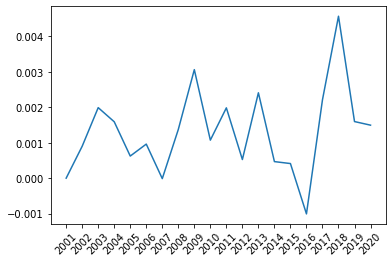

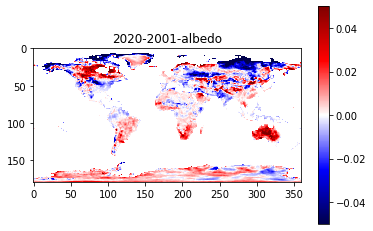

In [2]:
def month_fill(data,mask):
    data_mean=np.nanmean(data,axis=0)
    for i in range(12):
        data[i][mask[i]]=data_mean[mask[i]]
    return data
from tool import *
stat=torch.load(f'/data/hk/albedo/stat_sw-mean_sza-70_band-shortwave_kernel.pth')
_,sza_L=torch.load(root_path+'sza_and_szaL.pth')


albedo_all=np.zeros((12,20,18,180,360)).astype(np.float32)
area_all=np.zeros((12,20,18,180,360)).astype(np.float32)
mask=np.zeros((12,20,18,180,360))

for y in range(2001,2021):
    for m in range(1,13):
        albedo_all[m-1,y-2001]=stat[f'{y}-{m}-albedo']
        area_all[m-1,y-2001]=stat[f'{y}-{m}-typearea']
        mask[m-1,y-2001]=np.expand_dims(sza_L[y-2001,m-1],0).repeat(18,axis=0)
# albedo_all=month_fill(albedo_all,mask>=1)
albedo_all[albedo_all==0]=np.nan
albedo_all[mask>=1]=np.nan
area_all=month_fill(area_all,mask>=1)
albedo_all=month_fill(albedo_all,mask>=1)


albedo_y_list2=[]
for y in range(2001,2021):
    z=area_all[:,y-2001]*albedo_all[:,y-2001]
    z[np.isnan(z)]=0
    z=mt.reshape(12,1,1,1)*z/365/24/3600
    z=np.nansum(z,axis=0)
    z2=np.nansum(z,axis=0)
    z3=np.nansum(z2)/np.sum(stat[f'{y}-landarea'])
    albedo_y_list2.append(z3)
print(f'2001 albedo2: {albedo_y_list2[0]}')
print(f'2010 albedo2: {albedo_y_list2[19]}')
print(albedo_y_list2[19]-albedo_y_list2[0])
print(f'2001-2020 change2: ',((albedo_y_list2[-1]-albedo_y_list2[0])/albedo_y_list2[0])*100,'%')
plt.plot([str(i) for i in range(2001,2021)],[albedo_y_list2[i]-albedo_y_list2[0] for i in range(20)])
plt.xticks(rotation=45)
plt.show()




zz=[]
for y in range(2001,2021):
    z=area_all[:,y-2001]*albedo_all[:,y-2001]
    z[np.isnan(z)]=0
    z=mt.reshape(12,1,1,1)*z/365/24/3600
    z=np.nansum(z,axis=0)

    
    # z[z==0]=np.nan
    z2=np.nansum(z,axis=0)
    a=np.mean(area_all[:,y-2001],axis=0)
    a=np.sum(a,axis=0)
    z3=z2/a
    zz.append(z3)
# plt.figure(figsize=(30,20))
zz2020=zz[-1]
zz2001=zz[0]
zz2020[zz2001==0]=0
zz2001[zz2020==0]=0
plt.title(f'2020-2001-albedo')
plt.imshow(zz2020-zz2001,vmax=0.05,vmin=-0.05,cmap='seismic')
plt.colorbar()
plt.show()


In [ ]:
# # kka=np.load('/data/hk/albedo/rf_confuse_matrix_kernel.npy')
# # kka=kka2
# kka[np.isnan(kka)]=0
# season=[]
# for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
#     # month=1
#     kk=[]
#     for year in range(2001,2021):
#         now=datetime.datetime.strptime(f'2001-{month[0]}-1', '%Y-%m-%d')
#         month_time=(now+relativedelta(months=3)-now).total_seconds()
#         tt=np.array([kka[i-1,year-2001,:,:].sum() for i in month]).sum()/month_time/5.1e8/1e6
#         kk.append(tt)
#     kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
#     season.append(kk2)
    
# stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
# print(stds[-1]/2)
# kk2=[]
# for y in range(2001,2021):
#     ay=np.nansum(kka[:,y-2001,:,:])
#     kk2.append(ay/365/24/3600/5.1e8/1e6)
# kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
# print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
# print(mk(kk, alpha=0.05))
# plt.figure(figsize=(20,11),dpi=600)
# # plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)


# plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='thistle',alpha=0.6)

# plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='plum',alpha=0.7,linewidth=3,label='Global albedo')
# plt.plot([str(int(i)) for i in list(range(2001,2021))],[0]*20,color='gray',alpha=0.4,linewidth=3)
# # plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='#FA7F6F',alpha=1,linewidth=1.5, linestyle='--')
# # plt.annotate('2001 Albedo = 0.2051, Slope = -0.00003 year${^{-1}}$',[9,0],fontsize=20,color='#FA7F6F',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.025*10)/3.14159*180)
 





# season=[]
# for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
#     # month=1
#     kk=[]
#     for year in range(2001,2021):
#         now=datetime.datetime.strptime(f'2001-{month[0]}-1', '%Y-%m-%d')
#         month_time=(now+relativedelta(months=3)-now).total_seconds()
#         tt=np.array([kka[i-1,year-2001,:-1,:-1].sum() for i in month]).sum()/month_time/5.1e8/1e6
#         kk.append(tt)
#     kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
#     season.append(kk2)
    
# stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
# print(stds[-1]/2)
# kk2=[]
# for y in range(2001,2021):
#     ay=np.nansum(kka[:,y-2001,:-1,:-1])
#     kk2.append(ay/365/24/3600/5.1e8/1e6)
# kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
# print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
# print(mk(kk, alpha=0.05))
# # plt.figure(figsize=(20,11),dpi=600)
# # plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)



# plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='gray',alpha=0.3)

# plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='gray',alpha=0.6,linewidth=3,label='Global albedo(no snow)')
# # plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='gray',alpha=1,linewidth=1.5, linestyle='--')

# # plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='#FA7F6F',alpha=1,linewidth=1.5, linestyle='--')
# # plt.annotate('2001 Albedo = 0.2051, Slope = -0.00003 year${^{-1}}$',[9,0],fontsize=20,color='#FA7F6F',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.025*10)/3.14159*180)
 




# plt.grid(linestyle='-.')
# plt.legend(fontsize=20)
# plt.xlim(('2001', '2020'))
# # plt.ylim((-0.004, 0.022))
# plt.ylim((-0.004, 0.017))
# plt.xticks(fontsize=20,rotation=45)
# plt.yticks(fontsize=20)
# # plt.annotate('2001 Albedo = 0.2200, Slope = 0.00004 $ {y^{-1}}$',[11,0.000],fontsize=20,color='#FA7F6F',rotation=8.42030838e-05*20000)
# # plt.annotate('2001 Albedo = 0.1669, Slope = 0.00012 $ {y^{-1}}$',[11,0.001],fontsize=20,color='royalblue',rotation=8.42030838e-05*20000)
# # plt.annotate('2001 Albedo = 0.1579, Slope = 0.00019 $ {y^{-1}}$',[11,0.008],fontsize=20,color='#8ECFC9',rotation=0.0050*1200)
# # plt.annotate('2001 Albedo = 0.1938, Slope = 0.00008 $ {y^{-1}}$',[11,0.003],fontsize=20,color='black',rotation=8.42030838e-05*36000)


# # plt.ylabel(r'Radiative forcing (W/m$^2$)',fontsize=20)
# # plt.title('2001-2020 yearly albedo',fontsize=20)
# # plt.savefig('./figure/rf_sw_kernel.pdf',dpi=600)
# plt.show()


NameError: name 'kka' is not defined

In [3]:
#绘制曲线
from tool import *
stat=torch.load(f'/data/hk/albedo/stat_sw-mean_sza-70_band-shortwave_kernel.pth')
_,sza_L=torch.load(root_path+'sza_and_szaL.pth')


albedo_all=np.zeros((12,20,18,180,360)).astype(np.float32)
area_all=np.zeros((12,20,18,180,360)).astype(np.float32)
mask=np.zeros((12,20,18,180,360))

for y in range(2001,2021):
    for m in range(1,13):
        albedo_all[m-1,y-2001]=stat[f'{y}-{m}-albedo']
        area_all[m-1,y-2001]=stat[f'{y}-{m}-typearea']
        mask[m-1,y-2001]=np.expand_dims(sza_L[y-2001,m-1],0).repeat(18,axis=0)
# albedo_all=month_fill(albedo_all,mask>=1)
albedo_all[albedo_all==0]=np.nan
albedo_all[mask>=1]=np.nan
area_all=month_fill(area_all,mask>=1)
albedo_all=month_fill(albedo_all,mask>=1)    
season=[]
z=[]
aa=area_all*albedo_all
aa[aa==0]=np.nan
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for year in range(2001,2021):
        tt=[np.nansum(aa[i-1,year-2001,:,24:90-23,:],axis=0) for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(area_all[i-1,year-2001,:,24:90-23,:]) for i in month]).mean()
        kk.append(np.nansum(tt)/mm_area)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]

print(stds[-1]/2)
kk2=[]
for y in range(2001,2021):
    ay=aa[:,y-2001,:,24:90-23,:]*mt.reshape(12,1,1,1)/365/24/3600
    zzz=[np.nansum(ay[m])/np.nansum(area_all[m,y-2001,:,24:90-23,:]) for m in range(12)]
    kk2.append(np.array(zzz).sum())
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
plt.figure(figsize=(20,11),dpi=600)
# plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)



plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='#FA7F6F',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='#FA7F6F',alpha=0.7,linewidth=3,label='Temperate Northern Hemisphere')
plt.plot([str(int(i)) for i in list(range(2001,2021))],[0]*20,color='gray',alpha=0.4,linewidth=3)
plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='#FA7F6F',alpha=1,linewidth=1.5, linestyle='--')
plt.annotate('2001 Albedo = 0.2048, Slope = -0.00003 year${^{-1}}$',[9,0],fontsize=20,color='#FA7F6F',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.025*10)/3.14159*180)
 







season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for year in range(2001,2021):
        tt=[np.nansum(aa[i-1,year-2001,:,90-23:90+23,:],axis=0) for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(area_all[i-1,year-2001,:,90-23:90+23,:]) for i in month]).mean()
        kk.append(np.nansum(tt)/mm_area)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]

print(stds[-1]/2)
kk2=[]
for y in range(2001,2021):
    ay=aa[:,y-2001,:,90-23:90+23,:]*mt.reshape(12,1,1,1)/365/24/3600
    zzz=[np.nansum(ay[m])/np.nansum(area_all[m,y-2001,:,90-23:90+23,:]) for m in range(12)]
    kk2.append(np.array(zzz).sum())

kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))

plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='royalblue',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='#82B0D2',alpha=1,linewidth=3,label='Tropical')
plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='royalblue',alpha=1,linewidth=1.5, linestyle='--')
plt.annotate('2001 Albedo = 0.1669, Slope = 0.00012 year${^{-1}}$',[9,mk(kk, alpha=0.05)[4][0]*9+mk(kk, alpha=0.05)[4][1]+0.025/50],fontsize=20,color='royalblue',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.025*10)/3.14159*180)



season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for year in range(2001,2021):
        tt=[np.nansum(aa[i-1,year-2001,:,90+23:-24,:],axis=0) for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(area_all[i-1,year-2001,:,90+23:-24,:]) for i in month]).mean()
        kk.append(np.nansum(tt)/mm_area)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]

print(stds[-1]/2)

kk2=[]
for y in range(2001,2021):
    ay=aa[:,y-2001,:,90+23:-24,:]*mt.reshape(12,1,1,1)/365/24/3600
    zzz=[np.nansum(ay[m])/np.nansum(area_all[m,y-2001,:,90+23:-24,:]) for m in range(12)]
    kk2.append(np.array(zzz).sum())
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='#8ECFC9',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='#8ECFC9',alpha=0.7,linewidth=3,label='Temperate Southern Hemisphere')
plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='#8ECFC9',alpha=1,linewidth=1.5, linestyle='--')
plt.annotate('2001 Albedo = 0.1574, Slope = 0.0002 year${^{-1}}$',[9,mk(kk, alpha=0.05)[4][0]*9+mk(kk, alpha=0.05)[4][1]+0.025/50],fontsize=20,color='#8ECFC9',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.025*10)/3.14159*180)
# plt.show()






plt.grid(linestyle='-.')
plt.legend(fontsize=20)
plt.xlim(('2001', '2020'))
plt.ylim((-0.004, 0.017))
plt.xticks(fontsize=20,rotation=45)
plt.yticks(fontsize=20)
# plt.annotate('2001 Albedo = 0.2200, Slope = 0.00004 $ {y^{-1}}$',[11,0.000],fontsize=20,color='#FA7F6F',rotation=8.42030838e-05*20000)
# plt.annotate('2001 Albedo = 0.1669, Slope = 0.00012 $ {y^{-1}}$',[11,0.001],fontsize=20,color='royalblue',rotation=8.42030838e-05*20000)
# plt.annotate('2001 Albedo = 0.1579, Slope = 0.00019 $ {y^{-1}}$',[11,0.008],fontsize=20,color='#8ECFC9',rotation=0.0050*1200)
# plt.annotate('2001 Albedo = 0.1938, Slope = 0.00008 $ {y^{-1}}$',[11,0.003],fontsize=20,color='black',rotation=8.42030838e-05*36000)


plt.ylabel(r'short wave $\Delta \alpha$ ',fontsize=20)
# plt.title('2001-2020 yearly albedo',fontsize=20)
# plt.savefig('./figure/albedo_sw_kernel.png',dpi=600)
plt.show()



0.0009451119815330797
0.204780091942344 0.20523841246425162 0.0004583205219076125
(0, 0.7702877264736667, -2.6252915806442242e-05, -0.29199855803537256, [array([-2.62529158e-05]), 0.001555203843166685])
0.00026136964134632794
0.16685706238901943 0.1698940379593544 0.003036975570334971
(1, 0.0008324862576862824, 0.0001229771665183716, 3.3417612752937083, [array([0.00012298]), 0.0006251225963345001])
0.001028348139030569
0.15735235067709336 0.17199448502563425 0.014642134348540892
(0, 0.2843217140080183, 0.000201977542139229, 1.0706613794630326, [array([0.00020198]), 0.005192603741679215])


In [ ]:
0.014642134348540892/0.15735235067709336

0.09305316562183667

In [ ]:
0.0004583205219076125/0.204780091942344

0.0022381107341071663

In [ ]:

plt.figure(figsize=(20,11),dpi=600) 
season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for year in range(2001,2021):

        tt=[np.nansum(aa[i-1,year-2001,:,:24,:],axis=0) for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(area_all[i-1,year-2001,:,:24,:]) for i in month]).mean()
        kk.append(np.nansum(tt)/mm_area)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
print(stds[-1]/2)
kk2=[]
for y in range(2001,2021):
    ay=aa[:,y-2001,:,:24,:]*mt.reshape(12,1,1,1)/365/24/3600
    zzz=[np.nansum(ay[m])/np.nansum(area_all[m,y-2001,:,:24,:]) for m in range(12)]
    kk2.append(np.array(zzz).sum())
    
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='#FA7F6F',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='#FA7F6F',alpha=0.7,linewidth=3,label='The North Frigid zone')
plt.plot([str(int(i)) for i in list(range(2001,2021))],[0]*20,color='gray',alpha=0.4,linewidth=3)
plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='#FA7F6F',alpha=1,linewidth=1.5, linestyle='--')
plt.annotate('2001 Albedo = 0.4026, Slope = -0.00033 year${^{-1}}$',[9,mk(kk, alpha=0.05)[4][0]*18+mk(kk, alpha=0.05)[4][1]+0.025/50],fontsize=20,color='#FA7F6F',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.025*10)/3.14159*120)






season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for year in range(2001,2021):
        tt=[np.nansum(aa[i-1,year-2001,:,-24:,:],axis=0) for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(area_all[i-1,year-2001,:,-24:,:]) for i in month]).mean()
        kk.append(np.nansum(tt)/mm_area)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
print(stds[-1]/2)
kk2=[]
for y in range(2001,2021):
    ay=aa[:,y-2001,:,-24:,:]*mt.reshape(12,1,1,1)/365/24/3600
    zzz=[np.nansum(ay[m])/np.nansum(area_all[m,y-2001,:,-24:,:]) for m in range(12)]
    kk2.append(np.array(zzz).sum())
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='#8ECFC9',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='#8ECFC9',alpha=0.7,linewidth=3,label='The South Frigid Zone')
plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='#8ECFC9',alpha=1,linewidth=1.5, linestyle='--')
plt.annotate('2001 Albedo = 0.81, Slope = 0.0003 year${^{-1}}$',[9,mk(kk, alpha=0.05)[4][0]*9+mk(kk, alpha=0.05)[4][1]+0.02/30],fontsize=20,color='#8ECFC9',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.025*10)/3.14159*130)


plt.grid(linestyle='-.')
plt.legend(fontsize=20)
plt.xlim(('2001', '2020'))
# plt.ylim((-0.004, 0.022))
plt.xticks(fontsize=20,rotation=45)
plt.yticks(fontsize=20)
# plt.annotate('2001 Albedo = 0.2200, Slope = 0.00004 $ {y^{-1}}$',[11,0.000],fontsize=20,color='#FA7F6F',rotation=8.42030838e-05*20000)
# plt.annotate('2001 Albedo = 0.1669, Slope = 0.00012 $ {y^{-1}}$',[11,0.001],fontsize=20,color='royalblue',rotation=8.42030838e-05*20000)
# plt.annotate('2001 Albedo = 0.1579, Slope = 0.00019 $ {y^{-1}}$',[11,0.008],fontsize=20,color='#8ECFC9',rotation=0.0050*1200)
# plt.annotate('2001 Albedo = 0.1938, Slope = 0.00008 $ {y^{-1}}$',[11,0.003],fontsize=20,color='black',rotation=8.42030838e-05*36000)


plt.ylabel(r'short wave $\Delta \alpha$ ',fontsize=20)
# plt.title('2001-2020 yearly albedo',fontsize=20)
plt.savefig('./figure/albedo_ns_frigid_zone_kernel.pdf',dpi=600)
plt.show()

0.00046193771302607963
0.40256178497649187 0.3820376191540292 -0.020524165822462692
(0, 0.2561449666035265, -0.0003347465106621155, -1.1355499479153377, [array([-0.00033475]), -0.005468199628485543])
0.0006493545467885015
0.8100346765083877 0.8140788332232303 0.004044156714842595
(1, 0.0006576543953178415, 0.0002963137361830286, 3.4066498437460133, [array([0.00029631]), -0.0024652965721647033])


In [ ]:
season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for year in range(2001,2021):
        tt=[np.nansum(aa[i-1,year-2001,:-1,24:90-23,:],axis=0) for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(area_all[i-1,year-2001,:-1,24:90-23,:]) for i in month]).mean()
        kk.append(np.nansum(tt)/mm_area)

    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
print(stds[-1]/2)
kk2=[]
for y in range(2001,2021):
    ay=aa[:,y-2001,:-1,24:90-23,:]*mt.reshape(12,1,1,1)/365/24/3600
    zzz=[np.nansum(ay[m])/np.nansum(area_all[m,y-2001,:-1,24:90-23,:]) for m in range(12)]
    kk2.append(np.array(zzz).sum())
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
plt.figure(figsize=(20,11),dpi=600)
# plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)



plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='#FA7F6F',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='#FA7F6F',alpha=0.7,linewidth=3,label='Temperate Northern Hemisphere (no snow)')
plt.plot([str(int(i)) for i in list(range(2001,2021))],[0]*20,color='gray',alpha=0.4,linewidth=3)
plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='#FA7F6F',alpha=1,linewidth=1.5, linestyle='--')
plt.annotate('2001 Albedo = 0.1711, Slope = 0.00003 year${^{-1}}$',[9,0.0008],fontsize=20,color='#FA7F6F',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.019*10)/3.14159*180)








season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for year in range(2001,2021):
        tt=[np.nansum(aa[i-1,year-2001,:-1,90-23:90+23,:],axis=0) for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(area_all[i-1,year-2001,:-1,90-23:90+23,:]) for i in month]).mean()
        kk.append(np.nansum(tt)/mm_area)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
print(stds[-1]/2)
kk2=[]
for y in range(2001,2021):
    ay=aa[:,y-2001,:-1,90-23:90+23,:]*mt.reshape(12,1,1,1)/365/24/3600
    zzz=[np.nansum(ay[m])/np.nansum(area_all[m,y-2001,:-1,90-23:90+23,:]) for m in range(12)]
    kk2.append(np.array(zzz).sum())
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))

plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='royalblue',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='#82B0D2',alpha=1,linewidth=3,label='Tropical (no snow)')
plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='royalblue',alpha=1,linewidth=1.5, linestyle='--')
plt.annotate('2001 Albedo = 0.1667, Slope = 0.00012 year${^{-1}}$',[9,mk(kk, alpha=0.05)[4][0]*9+mk(kk, alpha=0.05)[4][1]+0.019/50],fontsize=20,color='royalblue',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.019*10)/3.14159*180)
 



season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for year in range(2001,2021):
        tt=[np.nansum(aa[i-1,year-2001,:-1,90+23:-24,:],axis=0) for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(area_all[i-1,year-2001,:-1,90+23:-24,:]) for i in month]).mean()
        kk.append(np.nansum(tt)/mm_area)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
print(stds[-1]/2)
kk2=[]
for y in range(2001,2021):
    ay=aa[:,y-2001,:-1,90+23:-24,:]*mt.reshape(12,1,1,1)/365/24/3600
    zzz=[np.nansum(ay[m])/np.nansum(area_all[m,y-2001,:-1,90+23:-24,:]) for m in range(12)]
    kk2.append(np.array(zzz).sum())
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='#8ECFC9',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='#8ECFC9',alpha=0.7,linewidth=3,label='Temperate Southern Hemisphere (no snow)')
plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='#8ECFC9',alpha=1,linewidth=1.5, linestyle='--')
# plt.show()
plt.annotate('2001 Albedo = 0.1511, Slope = 0.00025 year${^{-1}}$',[9,mk(kk, alpha=0.05)[4][0]*9+mk(kk, alpha=0.05)[4][1]+0.019/30],fontsize=20,color='#8ECFC9',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.019*10)/3.14159*180)






plt.grid(linestyle='-.')
plt.legend(fontsize=20)
plt.xlim(('2001', '2020'))
plt.ylim((-0.002, 0.017))
plt.xticks(fontsize=20,rotation=45)
plt.yticks(fontsize=20)
# plt.annotate('2001 Albedo = 0.2200, Slope = 0.00004 $ {y^{-1}}$',[11,0.000],fontsize=20,color='#FA7F6F',rotation=8.42030838e-05*20000)
# plt.annotate('2001 Albedo = 0.1669, Slope = 0.00012 $ {y^{-1}}$',[11,0.001],fontsize=20,color='royalblue',rotation=8.42030838e-05*20000)
# plt.annotate('2001 Albedo = 0.1579, Slope = 0.00019 $ {y^{-1}}$',[11,0.008],fontsize=20,color='#8ECFC9',rotation=0.0050*1200)
# plt.annotate('2001 Albedo = 0.1938, Slope = 0.00008 $ {y^{-1}}$',[11,0.003],fontsize=20,color='black',rotation=8.42030838e-05*36000)


plt.ylabel(r'short wave $\Delta \alpha$ ',fontsize=20)
# plt.title('2001-2020 yearly albedo',fontsize=20)
plt.savefig('./figure/albedo_sw_nts_nosnow_kernel.pdf',dpi=600)
plt.show()

0.000110591966010024
0.17109639788090114 0.1728623805091095 0.0017659826282083457
(0, 0.3467641835161843, 3.429439336610407e-05, 0.9408842425584227, [array([3.42943934e-05]), 0.0011964496976861441])
0.00025535239069260693


0.16674924544324443 0.1697930659003058 0.0030438204570613636
(1, 0.0016490105363544671, 0.0001229685755278161, 3.147095569936793, [array([0.00012297]), 0.0006292095430525384])
0.0011577635944547324
0.15111512734964633 0.16679194183489646 0.01567681448525013
(0, 0.2561449666035265, 0.000250173914392169, 1.1355499479153377, [array([0.00025017]), 0.005758208571992983])


In [ ]:
0.0017659826282083457/0.17109639788090114

0.010321565211662916

In [ ]:
season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for year in range(2001,2021):
        tt=[np.nansum(aa[i-1,year-2001,:,:,:],axis=0) for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(area_all[i-1,year-2001,:,:,:]) for i in month]).mean()
        kk.append(np.nansum(tt)/mm_area)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
kk2=[]
for y in range(2001,2021):
    ay=aa[:,y-2001,:,:,:]*mt.reshape(12,1,1,1)/365/24/3600
    zzz=[np.nansum(ay[m])/np.nansum(area_all[m,y-2001,:,:,:]) for m in range(12)]
    kk2.append(np.array(zzz).sum())
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
# print(mk(kk, alpha=0.05),'     ',kk2[0])
# plt.figure()
fig, ax1 = plt.subplots(figsize=(20,11),dpi=600)
plt.yticks(fontsize=20)
plt.xticks(fontsize=20,rotation=45)
ax2 = ax1.twinx()
# plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)


print(stds[-1]/2)
print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
ax1.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='thistle',alpha=0.6)
ax1.plot([str(int(i)) for i in list(range(2001,2021))],[0]*20,color='gray',alpha=0.4,linewidth=3)
ax1.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='plum',alpha=0.7,linewidth=3,label='Global albedo')
ax1.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='mediumorchid',alpha=1,linewidth=1.5, linestyle='--')
ax1.annotate('2001 Albedo = 0.2502, Slope = 0.00005 year${^{-1}}$',[9,mk(kk, alpha=0.05)[4][0]*9+mk(kk, alpha=0.05)[4][1]+0.011/50],fontsize=20,color='mediumorchid',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.011*10)/3.14159*180)

season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for y in range(2001,2021):
        tt=[np.nansum(aa[i-1,year-2001,:-1,:,:],axis=0) for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(area_all[i-1,y-2001,:-1,:,:]) for i in month]).mean()
        kk.append(np.nansum(tt)/mm_area)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
kk2=[]
for y in range(2001,2021):
    ay=aa[:,y-2001,:-1,:,:]*mt.reshape(12,1,1,1)/365/24/3600
    zzz=[np.nansum(ay[m])/np.nansum(area_all[m,y-2001,:-1,:,:]) for m in range(12)]
    kk2.append(np.array(zzz).sum())
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
# print(mk(kk, alpha=0.05),'     ',kk2[0])
# plt.figure(figsize=(20,11),dpi=600)
# plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)

print(stds[-1]/2)

print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
ax1.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='gray',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
# ax1.plot([str(int(i)) for i in list(range(2001,2021))],[0]*20,color='gray',alpha=0.4,linewidth=3)
ax1.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='gray',alpha=0.6,linewidth=3,label='Global albedo(no snow)')
ax1.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='gray',alpha=1,linewidth=1.5, linestyle='--')
ax1.annotate('2001 Albedo = 0.1670, Slope = 0.00009 year${^{-1}}$',[9,mk(kk, alpha=0.05)[4][0]*9+mk(kk, alpha=0.05)[4][1]+0.011/50],fontsize=20,color='gray',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.011*10)/3.14159*180)
ax1.grid(linestyle='-.')
# ax1.legend(fontsize=20)
ax1.set_xlim(('2001', '2020'))
ax1.set_ylim((-0.004, 0.007))


# plt.annotate('2001 Albedo = 0.1669, Slope = 0.00012 $ {y^{-1}}$',[11,0.001],fontsize=20,color='royalblue',rotation=8.42030838e-05*20000)
# plt.annotate('2001 Albedo = 0.1579, Slope = 0.00019 $ {y^{-1}}$',[11,0.008],fontsize=20,color='#8ECFC9',rotation=0.0050*1200)
# plt.annotate('2001 Albedo = 0.1938, Slope = 0.00008 $ {y^{-1}}$',[11,0.003],fontsize=20,color='black',rotation=8.42030838e-05*36000)


ax1.set_ylabel(r'short wave $\Delta \alpha$ ',fontsize=20)
# plt.title('2001-2020 yearly albedo',fontsize=20)
plt.yticks(fontsize=20)



ms=[[3,4,5],[6,7,8],[9,10,11],[12,1,2]]
area_snow_season=np.zeros((20,4))
for y in range(20):
    for i in range(4):
        area_snow_season[y,i]=np.array([np.nansum(area_all[ms[i][0]-1,y,-1]),
                                        np.nansum(area_all[ms[i][1]-1,y,-1]),
                                        np.nansum(area_all[ms[i][2]-1,y,-1])]).mean()
for y in range(1,20):
    area_snow_season[y,:]=area_snow_season[y,:]-area_snow_season[0,:]
area_snow_season[0,:]=0
stds=[np.std([area_snow_season[i,0],area_snow_season[i,1],area_snow_season[i,2],area_snow_season[i,3]]) for i in range(20)]
print(stds[-1]/2)

    
dif_area_y=[0]+[np.nansum(np.nanmean(area_all[:,i,-1],axis=0))-np.nansum(np.nanmean(area_all[:,0,-1],axis=0)) for i in range(1,20)]

# plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)


print(mk(np.array(dif_area_y)/1e6, alpha=0.05),'     ',np.nansum(np.nanmean(area_all[:,0,-1],axis=0)))
ax2.fill_between([str(int(i)) for i in list(range(2001,2021))],(np.array(dif_area_y)-np.array(stds)/2)/1e6,(np.array(dif_area_y)+np.array(stds)/2)/1e6,color='deepskyblue',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
ax2.plot([str(int(i)) for i in list(range(2001,2021))],np.array(dif_area_y)/1e6,color='deepskyblue',alpha=0.7,linewidth=3,label='Snow area')
ax2.plot([str(int(i)) for i in list(range(2001,2021))],[mk(np.array(dif_area_y)/1e6, alpha=0.05)[4][0]*i+mk(np.array(dif_area_y)/1e6, alpha=0.05)[4][1] for i in range(1,21)],color='deepskyblue',alpha=1,linewidth=1.5, linestyle='--')
kk=np.array(dif_area_y)/1e6
ax2.annotate('2001 Snow area = 23.84, Slope = -0.0286 year${^{-1}}$',[9,-0.47],fontsize=20,color='deepskyblue',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/4.4*10)/3.14159*180)


fig.legend(fontsize=20,bbox_to_anchor=(0.3, 1), bbox_transform=ax1.transAxes)
ax2.set_ylim((-1.6, 2.8))
ax2.set_ylabel(r'snow area (×10$^6$km$^2$) ',fontsize=20)

fig.savefig('./figure/albedo_sw_and_snowarea_kernel.pdf',dpi=600)
fig.show()

0.00047697501721094164
0.2501595564112509 0.2516553311549183 0.0014957747436673552
(0, 0.49566272449002957, 4.960083401683118e-05, 0.6813299687492026, [array([4.9600834e-05]), 0.0007908055534837113])
0.0002877132137761676
0.16699090485487883 0.17063886067775813 0.0036479558228793008
(1, 0.034955072643630514, 9.393316209280582e-05, 2.108878474699913, [array([9.39331621e-05]), 0.0015422431481159032])
184611.35764876948
(-1, 0.012482226584454192, -0.02860382857142858, -2.498209885413743, [array([-0.02860383]), 0.007387200000000038])       23835504.0


In [ ]:
import numpy as np
from scipy.stats import norm

def mann_kendall_test(x):
    """
    Mann-Kendall trend test for a given data sequence x.
    Args:
        x: A list or numpy array of data sequence.
    Returns:
        trend: The calculated trend (positive, negative or no trend).
        p_value: The p-value of the test.
    """
    alpha=0.05
    n = len(x)
    s = 0
    for i in range(n - 1):
        for j in range(i + 1, n):
            s += np.sign(x[j] - x[i])
    
    # Calculate the variance of the test statistic.
    var_s = (n * (n - 1) * (2 * n + 5)) / 18
    
    # Calculate the standardized test statistic.
    if s > 0:
        z = (s - 1) / np.sqrt(var_s)
    elif s < 0:
        z = (s + 1) / np.sqrt(var_s)
    else:
        z = 0
    
    # Calculate the p-value of the test.
    p_value = 2 * (1 - norm.cdf(abs(z)))
    
    # Determine the trend based on the sign of the test statistic.
    if p_value < alpha:
        if z > 0:
            trend = 'increasing'
        elif z < 0:
            trend = 'decreasing'
        else:
            trend = 'no trend'
    else:
        trend = 'no trend'
    return trend, p_value
season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for year in range(2001,2021):
        tt=[np.nansum(aa[i-1,year-2001,:,:,:],axis=0) for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(area_all[i-1,year-2001,:,:,:]) for i in month]).mean()
        kk.append(np.nansum(tt)/mm_area)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
kk2=[]
for y in range(2001,2021):
    ay=aa[:,y-2001,:,:,:]*mt.reshape(12,1,1,1)/365/24/3600
    zzz=[np.nansum(ay[m])/np.nansum(area_all[m,y-2001,:,:,:]) for m in range(12)]
    kk2.append(np.array(zzz).sum())
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]

# print(mk(kk, alpha=0.05),'     ',kk2[0])
# plt.figure()
fig, ax1 = plt.subplots(figsize=(20,11),dpi=600)
plt.yticks(fontsize=20)
plt.xticks(fontsize=20,rotation=45)
ax2 = ax1.twinx()
# plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)

print(mann_kendall_test(kk))
print(stds[-1]/2)
print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
ax1.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='thistle',alpha=0.6)
ax1.plot([str(int(i)) for i in list(range(2001,2021))],[0]*20,color='gray',alpha=0.4,linewidth=3)
ax1.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='plum',alpha=0.7,linewidth=3,label='Global albedo')
ax1.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='mediumorchid',alpha=1,linewidth=1.5, linestyle='--')
ax1.annotate('2001 Albedo = 0.2502, Slope = 0.00005 year${^{-1}}$',[9,mk(kk, alpha=0.05)[4][0]*9+mk(kk, alpha=0.05)[4][1]+0.011/50],fontsize=20,color='mediumorchid',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.011*10)/3.14159*180)

season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for y in range(2001,2021):
        tt=[np.nansum(aa[i-1,year-2001,:-1,:,:],axis=0) for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(area_all[i-1,y-2001,:-1,:,:]) for i in month]).mean()
        kk.append(np.nansum(tt)/mm_area)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
kk2=[]
for y in range(2001,2021):
    ay=aa[:,y-2001,:-1,:,:]*mt.reshape(12,1,1,1)/365/24/3600
    zzz=[np.nansum(ay[m])/np.nansum(area_all[m,y-2001,:-1,:,:]) for m in range(12)]
    kk2.append(np.array(zzz).sum())
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
# print(mk(kk, alpha=0.05),'     ',kk2[0])
# plt.figure(figsize=(20,11),dpi=600)
# plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)
print(mann_kendall_test(kk))
print(stds[-1]/2)

print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
ax1.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='gray',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
# ax1.plot([str(int(i)) for i in list(range(2001,2021))],[0]*20,color='gray',alpha=0.4,linewidth=3)
ax1.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='gray',alpha=0.6,linewidth=3,label='Global albedo(no snow)')
ax1.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='gray',alpha=1,linewidth=1.5, linestyle='--')
ax1.annotate('2001 Albedo = 0.1670, Slope = 0.00009 year${^{-1}}$',[9,mk(kk, alpha=0.05)[4][0]*9+mk(kk, alpha=0.05)[4][1]+0.011/50],fontsize=20,color='gray',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.011*10)/3.14159*180)
ax1.grid(linestyle='-.')
# ax1.legend(fontsize=20)
ax1.set_xlim(('2001', '2020'))
ax1.set_ylim((-0.004, 0.007))


# plt.annotate('2001 Albedo = 0.1669, Slope = 0.00012 $ {y^{-1}}$',[11,0.001],fontsize=20,color='royalblue',rotation=8.42030838e-05*20000)
# plt.annotate('2001 Albedo = 0.1579, Slope = 0.00019 $ {y^{-1}}$',[11,0.008],fontsize=20,color='#8ECFC9',rotation=0.0050*1200)
# plt.annotate('2001 Albedo = 0.1938, Slope = 0.00008 $ {y^{-1}}$',[11,0.003],fontsize=20,color='black',rotation=8.42030838e-05*36000)


ax1.set_ylabel(r'short wave $\Delta \alpha$ ',fontsize=20)
# plt.title('2001-2020 yearly albedo',fontsize=20)
plt.yticks(fontsize=20)



ms=[[3,4,5],[6,7,8],[9,10,11],[12,1,2]]
area_snow_season=np.zeros((20,4))
for y in range(20):
    for i in range(4):
        area_snow_season[y,i]=np.array([np.nansum(area_all[ms[i][0]-1,y,-1]),
                                        np.nansum(area_all[ms[i][1]-1,y,-1]),
                                        np.nansum(area_all[ms[i][2]-1,y,-1])]).mean()
for y in range(1,20):
    area_snow_season[y,:]=area_snow_season[y,:]-area_snow_season[0,:]
area_snow_season[0,:]=0
stds=[np.std([area_snow_season[i,0],area_snow_season[i,1],area_snow_season[i,2],area_snow_season[i,3]]) for i in range(20)]

print(stds[-1]/2)

    
dif_area_y=[0]+[np.nansum(np.nanmean(area_all[:,i,-1],axis=0))-np.nansum(np.nanmean(area_all[:,0,-1],axis=0)) for i in range(1,20)]

# plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)

print(mann_kendall_test(dif_area_y))
print(mk(np.array(dif_area_y)/1e6, alpha=0.05),'     ',np.nansum(np.nanmean(area_all[:,0,-1],axis=0)))
ax2.fill_between([str(int(i)) for i in list(range(2001,2021))],(np.array(dif_area_y)-np.array(stds)/2)/1e6,(np.array(dif_area_y)+np.array(stds)/2)/1e6,color='deepskyblue',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
ax2.plot([str(int(i)) for i in list(range(2001,2021))],np.array(dif_area_y)/1e6,color='deepskyblue',alpha=0.7,linewidth=3,label='Snow area')
ax2.plot([str(int(i)) for i in list(range(2001,2021))],[mk(np.array(dif_area_y)/1e6, alpha=0.05)[4][0]*i+mk(np.array(dif_area_y)/1e6, alpha=0.05)[4][1] for i in range(1,21)],color='deepskyblue',alpha=1,linewidth=1.5, linestyle='--')
kk=np.array(dif_area_y)/1e6
ax2.annotate('2001 Snow area = 23.84, Slope = -0.0286 year${^{-1}}$',[9,-0.47],fontsize=20,color='deepskyblue',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/4.4*10)/3.14159*180)


fig.legend(fontsize=20,bbox_to_anchor=(0.3, 1), bbox_transform=ax1.transAxes)
ax2.set_ylim((-1.6, 2.8))
ax2.set_ylabel(r'snow area (×10$^6$km$^2$) ',fontsize=20)

# fig.savefig('./figure/albedo_sw_and_snowarea_kernel.pdf',dpi=600)
fig.show()

('no trend', 0.49566272449002957)
0.00047697501721094164
0.2501595564112509 0.2516553311549183 0.0014957747436673552
(0, 0.49566272449002957, 4.960083401683118e-05, 0.6813299687492026, [array([4.9600834e-05]), 0.0007908055534837113])
('increasing', 0.034955072643630514)
0.0002877132137761676
0.16699090485487883 0.17063886067775813 0.0036479558228793008
(1, 0.034955072643630514, 9.393316209280582e-05, 2.108878474699913, [array([9.39331621e-05]), 0.0015422431481159032])
184611.35764876948
('decreasing', 0.012482226584454192)
(-1, 0.012482226584454192, -0.02860382857142858, -2.498209885413743, [array([-0.02860383]), 0.007387200000000038])       23835504.0


In [ ]:
0.0036479558228793008/0.16699090485487883

0.021845236577701686

In [ ]:
0.0014957747436673552/0.2501595564112509

0.005979282843020275

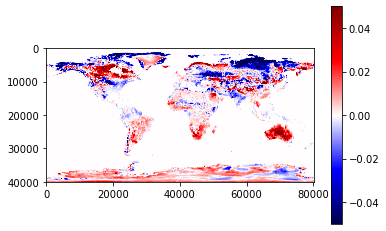

4701

In [ ]:
from tool import *
img_2001=rasterio.open(f"/data/hk/albedo/albedo_rebuilding/rebuilding2_albedo_2001.tif").read(1)
img_2020=rasterio.open(f"/data/hk/albedo/albedo_rebuilding/rebuilding2_albedo_2020.tif").read(1)
img_2001[img_2020==0]=0
img_2020[img_2001==0]=0
plt.imshow(img_2020-img_2001,vmax=0.05,vmin=-0.05,cmap='seismic')
plt.colorbar()
plt.show()
del img_2001,img_2020
gc.collect()

In [ ]:
#雪面积与反照率相关系数（去趋势）
#雪面积和反照率都使用70度的阈值
area_m=np.nansum(area_all,axis=3)
area_m=np.nansum(area_m,axis=3)
area=np.nanmean(area_m,axis=0)
kk2=[]
for y in range(2001,2021):
    ay=aa[:,y-2001,:,:,:]*mt.reshape(12,1,1,1)/365/24/3600
    zzz=[np.nansum(ay[m])/np.nansum(area_all[m,y-2001,:,:,:]) for m in range(12)]
    kk2.append(np.array(zzz).sum())
np.corrcoef([area[i+1,17]-area[i,17] for i in range(19)],[kk2[i+1]-kk2[i] for i in range(19)])

array([[1.        , 0.93461775],
       [0.93461775, 1.        ]])

2001 albedo2: 0.013902017594405956
2010 albedo2: 0.014207229979166063
2001-2020 change2:  2.195453880614575 %


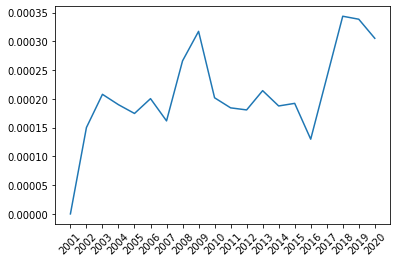

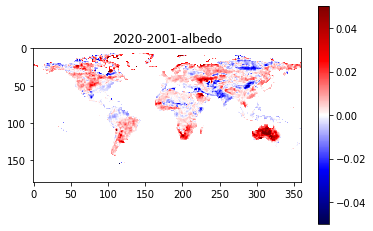

In [ ]:
# no snow
albedo_y_list2=[]
for y in range(2001,2021):
    z=area_all[:,y-2001,:-1]*albedo_all[:,y-2001,:-1]
    z[np.isnan(z)]=0
    z=mt.reshape(12,1,1,1)*z/365/24/3600
    z=np.nansum(z,axis=0)
    z2=np.nansum(z,axis=0)
    z3=np.nansum(z2)/np.sum(area_all[:,y-2001,:-1])
    albedo_y_list2.append(z3)

print(f'2001 albedo2: {albedo_y_list2[0]}')
print(f'2010 albedo2: {albedo_y_list2[19]}')
print(f'2001-2020 change2: ',((albedo_y_list2[-1]-albedo_y_list2[0])/albedo_y_list2[0])*100,'%')
plt.plot([str(i) for i in range(2001,2021)],[albedo_y_list2[i]-albedo_y_list2[0] for i in range(20)])
plt.xticks(rotation=45)
plt.show()
zz=[]
for y in range(2001,2021):
    z=area_all[:,y-2001,:-1]*albedo_all[:,y-2001,:-1]
    z[np.isnan(z)]=0
    z=mt.reshape(12,1,1,1)*z/365/24/3600
    z=np.nansum(z,axis=0)

    
    # z[z==0]=np.nan
    z2=np.nansum(z,axis=0)
    a=np.mean(area_all[:,y-2001,:-1],axis=0)
    a=np.sum(a,axis=0)
    z3=z2/a
    zz.append(z3)
# plt.figure(figsize=(30,20))
zz2020=zz[-1]
zz2001=zz[0]
zz2020[zz2001==0]=0
zz2001[zz2020==0]=0
plt.title(f'2020-2001-albedo')
plt.imshow(zz2020-zz2001,vmax=0.05,vmin=-0.05,cmap='seismic')
plt.colorbar()
plt.show()


In [4]:
from tool import *
data_m=torch.load('/data/hk/albedo/confuse_matrix/confuse_matrix_2020.pth')
mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
data_m[mask_t>=1]=np.nan
data_m=month_fill(data_m,mask_t>=1)
data_y=np.nanmean(data_m,axis=0)
transf=np.nansum(data_y,axis=0)
transf=np.nansum(transf,axis=0)
dif_al=[]
for m in range(12):
    exp1_2020=np.expand_dims(albedo_all[m,-1],0).repeat(18,axis=0)
    exp0_2001=np.expand_dims(albedo_all[m,0],1).repeat(18,axis=1)
    dif_al_m=(exp1_2020-exp0_2001).transpose((2,3,0,1))*data_m[m]
    dif_al.append(dif_al_m*mt[m]/365/24/3600)
dif_al=np.stack(dif_al)
print('delta albedo:',np.nansum(dif_al)/np.sum(transf))
print('')
print('计算方法为和雪的扩张和收缩造成的albedo都归因于雪。')
print('type        nochange              add              sub               all')
temp=0
temp2=0
all=np.nansum(dif_al)
for t in range(18):

    if t==17:
        nc=np.nansum(dif_al[:,:,:,t,t])
        sub=np.nansum(dif_al[:,:,:,t])-nc
        add=np.nansum(dif_al[:,:,:,:,t])-nc
        print(type_code[t],'     ',
            to_str(nc/all*100,'%'),'     ',
            to_str((add+sub)/all*100,'%'),'     ',
            # to_str(sub/all*100,'%'),'     ',
            to_str((nc+(sub+add))/all*100,'%'),'     ',)
        temp2+=(sub+add)
    else:
        nc=np.nansum(dif_al[:,:,:,t,t])
        sub=np.nansum(dif_al[:,:,:,t,:-1])-nc
        add=np.nansum(dif_al[:,:,:,:-1,t])-nc
        print(type_code[t],'     ',
            to_str(nc/all*100,'%'),'     ',
            to_str((add+sub)/all*100,'%'),'     ',
            # to_str(sub/all*100,'%'),'     ',
            to_str((nc+(sub+add))/all*100,'%'),'     ',)
        temp2+=(sub+add)/2
    temp+=nc
print('')
print('nochange:',temp/np.sum(transf))
print('change:',(temp2)/np.sum(transf))
print('')
print('nochange except snow:',(temp-nc)/np.sum(transf))
print('change except snow:',(temp2-sub-add)/np.sum(transf))
print('')
print('nochanged snow:',nc/np.sum(transf))
print('changed snow:',(sub+add)/np.sum(transf))


delta albedo: 0.0014960914

计算方法为和雪的扩张和收缩造成的albedo都归因于雪。
type        nochange              add              sub               all
EN_Forests                     3.12%          3.25%          6.37%         
EB_Forests                     -8.37%         5.58%          -2.79%        
DN_Forests                     -0.35%         -0.35%         -0.7%         
DB_Forests                     1.44%          1.65%          3.08%         
M_Forests                      4.69%          1.52%          6.2%          
C_Shrublands                   1.65%          2.22%          3.87%         
O_Shrublands                   66.67%         2.95%          69.62%        
W_Savannas                     7.76%          10.27%         18.02%        
Savannas                       16.09%         12.08%         28.17%        
Grasslands                     52.11%         14.54%         66.65%        
Permanent_Wetlands             1.74%          0.41%          2.15%         
Croplands                      16.

In [5]:
kk=[[],[],[],[]]

data_m=torch.load(f'/data/hk/albedo/confuse_matrix/confuse_matrix_2020.pth')
mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
data_m[mask_t>=1]=np.nan
data_m=month_fill(data_m,mask_t>=1)
data_m[:,:,:,-1,:]=0
data_m[:,:,:,:,-1]=0
z=albedo_all[:,0].transpose((0,2,3,1)).reshape((12,180,360,18,1))*data_m
n=0
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    tt=[z[i-1,24:90-23] for i in month]
    mts=np.array([mt[i-1] for i in month]).reshape(3,1,1,1,1)
    tt=np.stack(tt)*mts/np.sum(mts)
    mm_area=np.array([np.nansum(data_m[i-1,24:90-23]) for i in month]).mean()
    kk[n].append(np.nansum(tt)/mm_area)
    n+=1
# [:,90+23:-24]

In [6]:
kk

[[0.1752053877383719],
 [0.1635849815137871],
 [0.16834703222633957],
 [0.17661534064660017]]

In [108]:
data_m=torch.load(f'/data/hk/albedo/confuse_matrix/confuse_matrix_2020.pth')
mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
data_m[mask_t>=1]=np.nan
data_m=month_fill(data_m,mask_t>=1)
data_m[:,:,:,-1,:]=0
data_m[:,:,:,:,-1]=0
z=albedo_all[:,0].transpose((0,2,3,1)).reshape((12,180,360,18,1))*data_m
z[np.isnan(z)]=0
z=z*(mt.reshape(12,1,1,1,1)/365/24/3600)
np.nansum(z[:,24:90-23])/np.nansum(np.nanmean(data_m[:,24:90-23],axis=0))


0.17049797777655876

In [113]:

season=[]
kk=[[0.1752053877383719],
 [0.1635849815137871],
 [0.16834703222633957],
 [0.17661534064660017]]
for y in range(2002,2021):
    data_m=torch.load(f'/data/hk/albedo/confuse_matrix/confuse_matrix_{y}.pth')
    mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
    data_m[mask_t>=1]=np.nan
    data_m=month_fill(data_m,mask_t>=1)
    data_m[:,:,:,-1,:]=0
    data_m[:,:,:,:,-1]=0
    z=albedo_all[:,y-2001].transpose((0,2,3,1)).reshape((12,180,360,1,18))*data_m
    n=0
    for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
        tt=[z[i-1,24:90-23] for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(data_m[i-1,24:90-23]) for i in month]).mean()
        kk[n].append(np.nansum(tt)/mm_area)
        n+=1
# season=[]
for i in range(4):
    kk2=[0]+[kk[i][j]-kk[i][0] for j in range(1,20)]
    season.append(kk2)
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]


kk2=[0.17049797777655876]
for y in tqdm(range(2002,2021)):
    
    data_m=torch.load(f'/data/hk/albedo/confuse_matrix/confuse_matrix_{y}.pth')
    mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
    data_m[mask_t>=1]=np.nan
    data_m=month_fill(data_m,mask_t>=1)
    data_m[:,:,:,-1,:]=0
    data_m[:,:,:,:,-1]=0
    z=albedo_all[:,y-2001].transpose((0,2,3,1)).reshape((12,180,360,1,18))*data_m
    z[np.isnan(z)]=0
    z=z*(mt.reshape(12,1,1,1,1)/365/24/3600)
    kk2.append(np.nansum(z[:,24:90-23])/np.nansum(np.nanmean(data_m[:,24:90-23],axis=0)))
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
print(stds[-1]/2)

print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))

plt.figure(figsize=(20,11),dpi=600)
# plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)



plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='#FA7F6F',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='#FA7F6F',alpha=0.7,linewidth=3,label='Temperate Northern Hemisphere (no snow)')
plt.plot([str(int(i)) for i in list(range(2001,2021))],[0]*20,color='gray',alpha=0.4,linewidth=3)
plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='#FA7F6F',alpha=1,linewidth=1.5, linestyle='--')
plt.annotate('2001 Albedo = 0.1705, Slope = 0.00005 year${^{-1}}$',[9,0.0008],fontsize=20,color='#FA7F6F',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.019*10)/3.14159*180)






season=[]
kk=[[0.16698474404715252],
 [0.16662145512319065],
 [0.16637447952466344],
 [0.16703309530095362]]
for y in range(2002,2021):
    data_m=torch.load(f'/data/hk/albedo/confuse_matrix/confuse_matrix_{y}.pth')
    mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
    data_m[mask_t>=1]=np.nan
    data_m=month_fill(data_m,mask_t>=1)
    data_m[:,:,:,-1,:]=0
    data_m[:,:,:,:,-1]=0
    z=albedo_all[:,y-2001].transpose((0,2,3,1)).reshape((12,180,360,1,18))*data_m
    n=0
    for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
        tt=[z[i-1,90-23:90+24] for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(data_m[i-1,90-23:90+24]) for i in month]).mean()
        kk[n].append(np.nansum(tt)/mm_area)
        n+=1
# season=[]
for i in range(4):
    kk2=[0]+[kk[i][j]-kk[i][0] for j in range(1,20)]
    season.append(kk2)
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]


kk2=[0.16675298477082404]
for y in tqdm(range(2002,2021)):
    
    data_m=torch.load(f'/data/hk/albedo/confuse_matrix/confuse_matrix_{y}.pth')
    mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
    data_m[mask_t>=1]=np.nan
    data_m=month_fill(data_m,mask_t>=1)
    data_m[:,:,:,-1,:]=0
    data_m[:,:,:,:,-1]=0
    z=albedo_all[:,y-2001].transpose((0,2,3,1)).reshape((12,180,360,1,18))*data_m
    z[np.isnan(z)]=0
    z=z*(mt.reshape(12,1,1,1,1)/365/24/3600)
    kk2.append(np.nansum(z[:,90-23:90+24])/np.nansum(np.nanmean(data_m[:,90-23:90+24],axis=0)))
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
print(stds[-1]/2)

print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))

plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='royalblue',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='#82B0D2',alpha=1,linewidth=3,label='Tropical (no snow)')
plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='royalblue',alpha=1,linewidth=1.5, linestyle='--')
plt.annotate('2001 Albedo = 0.1668, Slope = 0.00012 year${^{-1}}$',[9,mk(kk, alpha=0.05)[4][0]*9+mk(kk, alpha=0.05)[4][1]+0.019/50],fontsize=20,color='royalblue',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.019*10)/3.14159*180)
 


season=[]
kk=[[0.15332827281481567],
 [0.14869437026749022],
 [0.1481278170242655],
 [0.154500847039972]]
for y in range(2002,2021):
    data_m=torch.load(f'/data/hk/albedo/confuse_matrix/confuse_matrix_{y}.pth')
    mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
    data_m[mask_t>=1]=np.nan
    data_m=month_fill(data_m,mask_t>=1)
    data_m[:,:,:,-1,:]=0
    data_m[:,:,:,:,-1]=0
    z=albedo_all[:,y-2001].transpose((0,2,3,1)).reshape((12,180,360,1,18))*data_m
    n=0
    for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
        tt=[z[i-1,90+23:-24] for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(data_m[i-1,90+23:-24]) for i in month]).mean()
        kk[n].append(np.nansum(tt)/mm_area)
        n+=1
# season=[]
for i in range(4):
    kk2=[0]+[kk[i][j]-kk[i][0] for j in range(1,20)]
    season.append(kk2)
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]


kk2=[0.15116584351087992]
for y in tqdm(range(2002,2021)):
    
    data_m=torch.load(f'/data/hk/albedo/confuse_matrix/confuse_matrix_{y}.pth')
    mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
    data_m[mask_t>=1]=np.nan
    data_m=month_fill(data_m,mask_t>=1)
    data_m[:,:,:,-1,:]=0
    data_m[:,:,:,:,-1]=0
    z=albedo_all[:,y-2001].transpose((0,2,3,1)).reshape((12,180,360,1,18))*data_m
    z[np.isnan(z)]=0
    z=z*(mt.reshape(12,1,1,1,1)/365/24/3600)
    kk2.append(np.nansum(z[:,90+23:-24])/np.nansum(np.nanmean(data_m[:,90+23:-24],axis=0)))
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
print(stds[-1]/2)

print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='#8ECFC9',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='#8ECFC9',alpha=0.7,linewidth=3,label='Temperate Southern Hemisphere (no snow)')
plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='#8ECFC9',alpha=1,linewidth=1.5, linestyle='--')
# plt.show()
plt.annotate('2001 Albedo = 0.1511, Slope = 0.00025 year${^{-1}}$',[9,mk(kk, alpha=0.05)[4][0]*9+mk(kk, alpha=0.05)[4][1]+0.019/30],fontsize=20,color='#8ECFC9',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.019*10)/3.14159*180)






plt.grid(linestyle='-.')
plt.legend(fontsize=20)
plt.xlim(('2001', '2020'))
plt.ylim((-0.002, 0.017))
plt.xticks(fontsize=20,rotation=45)
plt.yticks(fontsize=20)
# plt.annotate('2001 Albedo = 0.2200, Slope = 0.00004 $ {y^{-1}}$',[11,0.000],fontsize=20,color='#FA7F6F',rotation=8.42030838e-05*20000)
# plt.annotate('2001 Albedo = 0.1669, Slope = 0.00012 $ {y^{-1}}$',[11,0.001],fontsize=20,color='royalblue',rotation=8.42030838e-05*20000)
# plt.annotate('2001 Albedo = 0.1579, Slope = 0.00019 $ {y^{-1}}$',[11,0.008],fontsize=20,color='#8ECFC9',rotation=0.0050*1200)
# plt.annotate('2001 Albedo = 0.1938, Slope = 0.00008 $ {y^{-1}}$',[11,0.003],fontsize=20,color='black',rotation=8.42030838e-05*36000)


plt.ylabel(r'short wave $\Delta \alpha$ ',fontsize=20)
# plt.title('2001-2020 yearly albedo',fontsize=20)
plt.savefig('./figure/albedo_sw_nts_nosnow_kernel2.pdf',dpi=600)
plt.show()

100%|██████████| 19/19 [01:16<00:00,  4.05s/it]


0.00017501470221656894
0.17049797777655876 0.1726886082470818 0.002190630470523036
(0, 0.2561449666035265, 4.7015354999722845e-05, 1.1355499479153377, [array([4.7015355e-05]), 0.0011903056118143089])


100%|██████████| 19/19 [01:17<00:00,  4.08s/it]


0.0002460909656605711
0.16675298477082404 0.16991289184231645 0.0031599070714924127
(1, 0.0006576543953178415, 0.000123707751611286, 3.4066498437460133, [array([0.00012371]), 0.0006112534274793195])


100%|██████████| 19/19 [01:16<00:00,  4.05s/it]


0.0011425938959520347
0.15116584351087992 0.16683827952178085 0.01567243601090093
(0, 0.2561449666035265, 0.00024966178098954564, 1.1355499479153377, [array([0.00024966]), 0.005772224053837])


In [112]:
0.1726886082470818-0.17049797777655876

0.002190630470523036

In [4]:
from tool import *
stat=torch.load(f'/data/hk/albedo/stat_sw-mean_sza-70_band-shortwave_kernel.pth')
_,sza_L=torch.load(root_path+'sza_and_szaL.pth')


albedo_all=np.zeros((12,20,18,180,360)).astype(np.float32)
area_all=np.zeros((12,20,18,180,360)).astype(np.float32)
mask=np.zeros((12,20,18,180,360))

for y in range(2001,2021):
    for m in range(1,13):
        albedo_all[m-1,y-2001]=stat[f'{y}-{m}-albedo']
        area_all[m-1,y-2001]=stat[f'{y}-{m}-typearea']
        mask[m-1,y-2001]=np.expand_dims(sza_L[y-2001,m-1],0).repeat(18,axis=0)
# albedo_all=month_fill(albedo_all,mask>=1)
albedo_all[albedo_all==0]=np.nan
albedo_all[mask>=1]=np.nan
area_all=month_fill(area_all,mask>=1)
albedo_all=month_fill(albedo_all,mask>=1)    
season=[]
z=[]
aa=area_all*albedo_all
aa[aa==0]=np.nan
import numpy as np
from scipy.stats import norm

def mann_kendall_test(x):
    """
    Mann-Kendall trend test for a given data sequence x.
    Args:
        x: A list or numpy array of data sequence.
    Returns:
        trend: The calculated trend (positive, negative or no trend).
        p_value: The p-value of the test.
    """
    alpha=0.05
    n = len(x)
    s = 0
    for i in range(n - 1):
        for j in range(i + 1, n):
            s += np.sign(x[j] - x[i])
    
    # Calculate the variance of the test statistic.
    var_s = (n * (n - 1) * (2 * n + 5)) / 18
    
    # Calculate the standardized test statistic.
    if s > 0:
        z = (s - 1) / np.sqrt(var_s)
    elif s < 0:
        z = (s + 1) / np.sqrt(var_s)
    else:
        z = 0
    
    # Calculate the p-value of the test.
    p_value = 2 * (1 - norm.cdf(abs(z)))
    
    # Determine the trend based on the sign of the test statistic.
    if p_value < alpha:
        if z > 0:
            trend = 'increasing'
        elif z < 0:
            trend = 'decreasing'
        else:
            trend = 'no trend'
    else:
        trend = 'no trend'
    return trend, p_value
season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for year in range(2001,2021):
        tt=[np.nansum(aa[i-1,year-2001,:,:,:],axis=0) for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(area_all[i-1,year-2001,:,:,:]) for i in month]).mean()
        kk.append(np.nansum(tt)/mm_area)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
kk2=[]
for y in range(2001,2021):
    ay=aa[:,y-2001,:,:,:]*mt.reshape(12,1,1,1)/365/24/3600
    zzz=[np.nansum(ay[m])/np.nansum(area_all[m,y-2001,:,:,:]) for m in range(12)]
    kk2.append(np.array(zzz).sum())
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
# print(mk(kk, alpha=0.05),'     ',kk2[0])
# plt.figure()
fig, ax1 = plt.subplots(figsize=(20,11),dpi=600)
plt.yticks(fontsize=20)
plt.xticks(fontsize=20,rotation=45)
ax2 = ax1.twinx()
# plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)

print(mann_kendall_test(kk2))
print(stds[-1]/2)
print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
ax1.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='thistle',alpha=0.6)
ax1.plot([str(int(i)) for i in list(range(2001,2021))],[0]*20,color='gray',alpha=0.4,linewidth=3)
ax1.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='plum',alpha=0.7,linewidth=3,label='Global albedo')
ax1.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='mediumorchid',alpha=1,linewidth=1.5, linestyle='--')
ax1.annotate('2001 Albedo = 0.2502, Slope = 0.00005 year${^{-1}}$',[9,mk(kk, alpha=0.05)[4][0]*9+mk(kk, alpha=0.05)[4][1]+0.011/50],fontsize=20,color='mediumorchid',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.011*10)/3.14159*180)



####################################
season=[]
kk=[[0.16995821684121826],
 [0.1620456693166442],
 [0.16548801987720624],
 [0.17035025247233082]]
for y in range(2002,2021):
    data_m=torch.load(f'/data/hk/albedo/confuse_matrix/confuse_matrix_{y}.pth')
    mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
    data_m[mask_t>=1]=np.nan
    data_m=month_fill(data_m,mask_t>=1)
    data_m[:,:,:,-1,:]=0
    data_m[:,:,:,:,-1]=0
    z=albedo_all[:,y-2001].transpose((0,2,3,1)).reshape((12,180,360,1,18))*data_m
    n=0
    for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
        tt=[z[i-1] for i in month]
        mts=np.array([mt[i-1] for i in month]).reshape(3,1,1,1,1)
        tt=np.stack(tt)*mts/np.sum(mts)
        mm_area=np.array([np.nansum(data_m[i-1]) for i in month]).mean()
        kk[n].append(np.nansum(tt)/mm_area)
        n+=1
# season=[]
for i in range(4):
    kk2=[0]+[kk[i][j]-kk[i][0] for j in range(1,20)]
    season.append(kk2)
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]


kk2=[0.16679990693607497]
for y in tqdm(range(2002,2021)):
    
    data_m=torch.load(f'/data/hk/albedo/confuse_matrix/confuse_matrix_{y}.pth')
    mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
    data_m[mask_t>=1]=np.nan
    data_m=month_fill(data_m,mask_t>=1)
    data_m[:,:,:,-1,:]=0
    data_m[:,:,:,:,-1]=0
    z=albedo_all[:,y-2001].transpose((0,2,3,1)).reshape((12,180,360,1,18))*data_m
    z[np.isnan(z)]=0
    z=z*(mt.reshape(12,1,1,1,1)/365/24/3600)
    kk2.append(np.nansum(z)/np.nansum(np.nanmean(data_m,axis=0)))
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
# print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
# print(mk(kk, alpha=0.05))
# plt.figure(figsize=(20,11),dpi=600)
# plt.plot(kk2)


########################################
print(mann_kendall_test(kk2))
print(stds[-1]/2)

print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
ax1.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='gray',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
# ax1.plot([str(int(i)) for i in list(range(2001,2021))],[0]*20,color='gray',alpha=0.4,linewidth=3)
ax1.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='gray',alpha=0.6,linewidth=3,label='Global albedo(no snow)')
ax1.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='gray',alpha=1,linewidth=1.5, linestyle='--')
ax1.annotate('2001 Albedo = 0.1668, Slope = 0.0001 year${^{-1}}$',[9,mk(kk, alpha=0.05)[4][0]*9+mk(kk, alpha=0.05)[4][1]+0.011/50],fontsize=20,color='gray',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.011*10)/3.14159*180)
ax1.grid(linestyle='-.')
# ax1.legend(fontsize=20)
ax1.set_xlim(('2001', '2020'))
ax1.set_ylim((-0.004, 0.007))


# plt.annotate('2001 Albedo = 0.1669, Slope = 0.00012 $ {y^{-1}}$',[11,0.001],fontsize=20,color='royalblue',rotation=8.42030838e-05*20000)
# plt.annotate('2001 Albedo = 0.1579, Slope = 0.00019 $ {y^{-1}}$',[11,0.008],fontsize=20,color='#8ECFC9',rotation=0.0050*1200)
# plt.annotate('2001 Albedo = 0.1938, Slope = 0.00008 $ {y^{-1}}$',[11,0.003],fontsize=20,color='black',rotation=8.42030838e-05*36000)


ax1.set_ylabel(r'short wave $\Delta \alpha$ ',fontsize=20)
# plt.title('2001-2020 yearly albedo',fontsize=20)
plt.yticks(fontsize=20)



ms=[[3,4,5],[6,7,8],[9,10,11],[12,1,2]]
area_snow_season=np.zeros((20,4))
for y in range(20):
    for i in range(4):
        area_snow_season[y,i]=np.array([np.nansum(area_all[ms[i][0]-1,y,-1]),
                                        np.nansum(area_all[ms[i][1]-1,y,-1]),
                                        np.nansum(area_all[ms[i][2]-1,y,-1])]).mean()
for y in range(1,20):
    area_snow_season[y,:]=area_snow_season[y,:]-area_snow_season[0,:]
area_snow_season[0,:]=0
stds=[np.std([area_snow_season[i,0],area_snow_season[i,1],area_snow_season[i,2],area_snow_season[i,3]]) for i in range(20)]
print(stds[-1]/2)

    
dif_area_y=[0]+[np.nansum(np.nanmean(area_all[:,i,-1],axis=0))-np.nansum(np.nanmean(area_all[:,0,-1],axis=0)) for i in range(1,20)]

# plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)


print(mk(np.array(dif_area_y)/1e6, alpha=0.05),'     ',np.nansum(np.nanmean(area_all[:,0,-1],axis=0)))
ax2.fill_between([str(int(i)) for i in list(range(2001,2021))],(np.array(dif_area_y)-np.array(stds)/2)/1e6,(np.array(dif_area_y)+np.array(stds)/2)/1e6,color='deepskyblue',alpha=0.3)
# plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
ax2.plot([str(int(i)) for i in list(range(2001,2021))],np.array(dif_area_y)/1e6,color='deepskyblue',alpha=0.7,linewidth=3,label='Snow area')
ax2.plot([str(int(i)) for i in list(range(2001,2021))],[mk(np.array(dif_area_y)/1e6, alpha=0.05)[4][0]*i+mk(np.array(dif_area_y)/1e6, alpha=0.05)[4][1] for i in range(1,21)],color='deepskyblue',alpha=1,linewidth=1.5, linestyle='--')
kk=np.array(dif_area_y)/1e6
ax2.annotate('2001 Snow area = 23.84, Slope = -0.0286 year${^{-1}}$',[9,-0.47],fontsize=20,color='deepskyblue',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/4.4*10)/3.14159*180)


fig.legend(fontsize=20,bbox_to_anchor=(0.3, 1), bbox_transform=ax1.transAxes)
ax2.set_ylim((-1.6, 2.8))
ax2.set_ylabel(r'snow area (×10$^6$km$^2$) ',fontsize=20)

# fig.savefig('./figure/albedo_sw_and_snowarea_kernel2.pdf',dpi=600)
fig.show()

('no trend', 0.49566272449002957)
0.00047697501721094164
0.2501595564112509 0.2516553311549183 0.0014957747436673552
(0, 0.49566272449002957, 4.960083401683118e-05, 0.6813299687492026, [array([4.9600834e-05]), 0.0007908055534837113])


100%|██████████| 19/19 [01:48<00:00,  5.73s/it]


('increasing', 0.017863627708934793)
7.585233303968528e-05
0.16679990693607497 0.17060722622462338 0.003807319288548411
(1, 0.017863627708934793, 9.734647949792147e-05, 2.368432748509133, [array([9.73464795e-05]), 0.0015401623121568582])
184611.35764876948
(-1, 0.012482226584454192, -0.02860382857142858, -2.498209885413743, [array([-0.02860383]), 0.007387200000000038])       23835504.0


In [6]:
mann_kendall_test(kk)

('decreasing', 0.012482226584454192)

In [96]:
0.17060722622462338-0.16679990693607497

0.003807319288548411

In [ ]:
0.16679990693607497

In [7]:
#反照率变化(无变化区域)
print('增减比例    2001年反照率     2020年   类别')
aaaa=[]
for t in range(18):
    albedo_t=[]
    for y in [2001,2020]:
        z=albedo_all[:,y-2001,t]*data_m[:,:,:,t,t]
        z[np.isnan(z)]=0
        z=z*(mt.reshape(12,1,1)/365/24/3600)
        albedo_t.append(np.nansum(z)/np.nansum(np.nanmean(data_m[:,:,:,t,t],axis=0)))
    albedo_t=[albedo_t[i] for i in range(2)]
    aaaa.append((albedo_t[-1]/albedo_t[0]-1)*100)
    print(to_str(aaaa[t],'%')+'    ',
          to_str(albedo_t[-1]-albedo_t[0],k=7)+'    ',
          to_str(albedo_t[0],k=5)+'    ',
          to_str(albedo_t[-1],k=5)+'    ',
          to_str(np.nansum(data_m[:,:,:,t,t])/12,k=5)+'    ',
          type_code[t])

增减比例    2001年反照率     2020年   类别
4.07%        0.0039843     0.09784      0.10183      1733713.5     EN_Forests              
-1.35%       -0.0016271     0.12072      0.11909      11387805.33333     EB_Forests              
-3.38%       -0.0042037     0.1245       0.1203       182549.79167     DN_Forests              
1.23%        0.0015427     0.12591      0.12745      2059665.66667     DB_Forests              
2.58%        0.0029953     0.11609      0.11908      3461837.33333     M_Forests               
8.43%        0.0105605     0.12532      0.13588      346311.04167     C_Shrublands            
8.84%        0.0150422     0.17018      0.18523      9806792.0     O_Shrublands            
2.01%        0.0024589     0.12232      0.12478      6993656.66667     W_Savannas              
2.35%        0.0030961     0.13157      0.13466      11503481.33333     Savannas                
3.04%        0.0050114     0.16481      0.16982      23012293.33333     Grasslands              
3.37%        

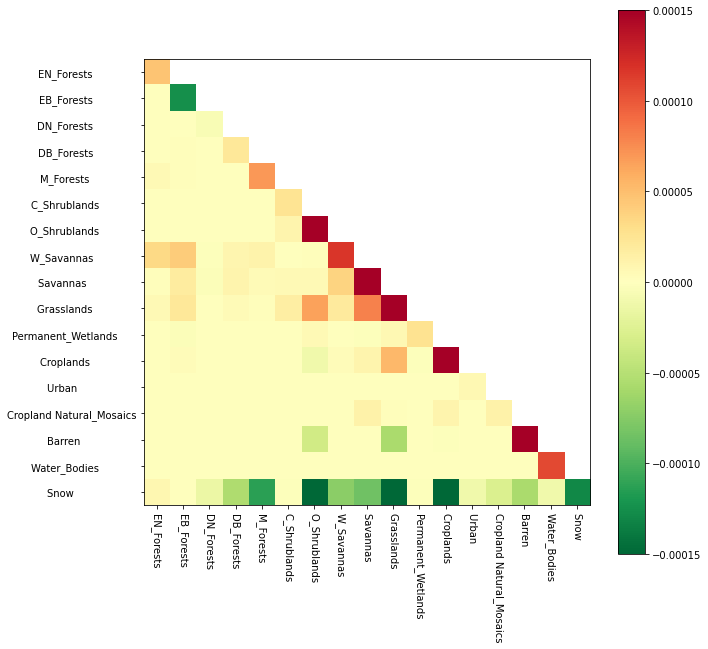

In [8]:
dif_al_tranf=np.nansum(dif_al.reshape(-1,18,18),axis=0)
dif_al_tranf=dif_al_tranf/np.sum(transf)
dif_al_tranf=np.delete(dif_al_tranf,14,axis=0)
dif_al_tranf=np.delete(dif_al_tranf,14,axis=1)


dif_al_tranf2=np.zeros((17,17))
for x in range(17):
    for y in range(17):
        dif_al_tranf2[x,y]=(dif_al_tranf[y,x]+dif_al_tranf[x,y])
        dif_al_tranf2[y,x]=np.nan
for i in range(17):
    dif_al_tranf2[i,i]=dif_al_tranf[i,i]

ll=[type_code[i] for i in range(18) if i!=14]


initial_cmap = cm.get_cmap('RdYlGn')
reversed_cmap = initial_cmap.reversed()
#x to y 减去y to x
plt.figure(figsize=(10,10))
plt.imshow(dif_al_tranf2,vmax=0.00015,vmin=-0.00015,cmap=reversed_cmap)
plt.yticks([i for i in range(17)],ll)
plt.xticks([i for i in range(17)],ll)
plt.xticks(rotation=-90)
plt.colorbar()
plt.show()

In [9]:
def to_log(k):
    k=k*1e7
    if np.isnan(k):
        return np.nan
    else:
        if k>=0:
            k=np.log10(k)
            if k<0:
                k=0
            return k
        else:
            k=np.log10(k*(-1))
            if k<0:
                k=0
            return -k
dif_al_tranf3=dif_al_tranf2.copy()
for x in range(17):
    for y in range(17):
        dif_al_tranf3[x,y]=to_log(dif_al_tranf3[x,y])
dif_al_tranf4=dif_al_tranf2.copy()
dif_al_tranf4=np.round(dif_al_tranf4*1e7)
# dif_al_tranf4=dif_al_tranf4.astype(np.int32)


In [10]:
[dif_al_tranf2[i,i] for i in range(17)]

[4.6688266593264416e-05,
 -0.0001252843940164894,
 -5.1885876928281505e-06,
 2.148148269043304e-05,
 7.01106182532385e-05,
 2.4727711206651293e-05,
 0.0009973946725949645,
 0.00011603541497606784,
 0.00024068757193163037,
 0.00077958864858374,
 2.5992423616116866e-05,
 0.0002538661065045744,
 6.354770448524505e-06,
 1.2288625839573797e-05,
 0.00018111872486770153,
 0.00010750668297987431,
 -0.0001296342961722985]

In [11]:
data_m=torch.load('/data/hk/albedo/confuse_matrix/confuse_matrix_2020.pth')
mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
data_m[mask_t>=2]=np.nan
data_m=month_fill(data_m,mask_t>=2)
data_y=np.nanmean(data_m,axis=0)
transf=np.nansum(data_y,axis=0)
transf=np.nansum(transf,axis=0)
transf2=transf.copy()
transf22=np.zeros((18,18))
for i in range(18):
    transf22[i,i]=0
for x in range(18):
    for y in range(18):
        transf22[x,y]=(transf2[y,x]-transf2[x,y])
        transf22[y,x]=0
# for i in range(18):
#     transf22[i,i]=transf2[i,i]
transf22[transf22==0]=np.nan
transf3=np.zeros((17,17))
transf3[:14,:14]=transf22[:14,:14]
transf3[14:,:14]=transf22[15:,:14]

transf3[:14,14:]=transf22[:14,15:]
transf3[14:,14:]=transf22[15:,15:]
box_indices=[]
for x in range(17):
    for y in range(17):  
        if transf3[x,y]<0:
          box_indices.append((x,y))  

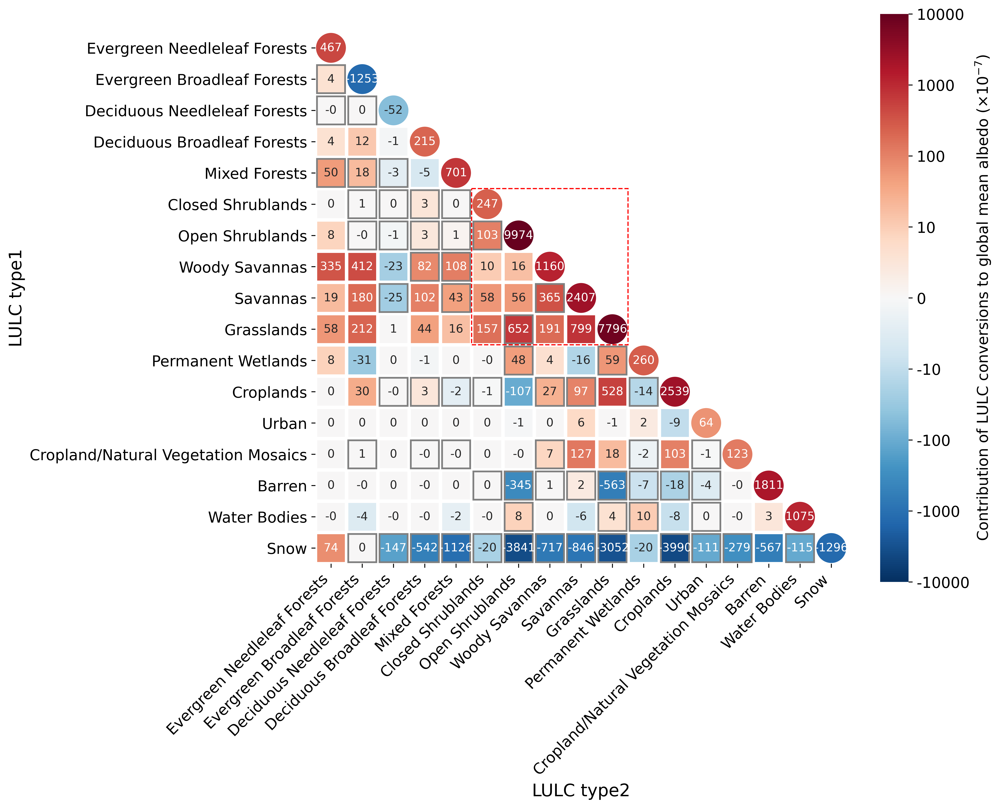

In [25]:
from matplotlib.patches import Circle
from matplotlib.patches import Rectangle
import seaborn as sns
names=['Evergreen Needleleaf Forests',
 'Evergreen Broadleaf Forests',
 'Deciduous Needleleaf Forests',
 'Deciduous Broadleaf Forests',
 'Mixed Forests',
 'Closed Shrublands',
 'Open Shrublands',
 'Woody Savannas',
 'Savannas',
 'Grasslands',
 'Permanent Wetlands',
 'Croplands',
 'Urban',
 'Cropland/Natural Vegetation Mosaics',
 'Barren',
 'Water Bodies',
 'Snow']
def heatmap_with_boxes(data, box_indices, ax=None, **kwargs):
    if not ax:
        ax = plt.gca()
    # ax.imshow(data, **kwargs)

    rows, cols = data.shape

    for i, j in box_indices:
        # 计算框的左下角坐标
        x = j
        y = i

        # 创建框对象并添加到图表中
        rect = Rectangle((x+0.05, y+0.05), 1-0.1, 1-0.1, linewidth=1.5, edgecolor='gray', facecolor='none')
        ax.add_patch(rect)

    ax.set_aspect('equal', adjustable='box')
def heatmap_with_c(data, box_indices, ax=None, **kwargs):
    if not ax:
        ax = plt.gca()
    # ax.imshow(data, **kwargs)

    rows, cols = data.shape
    cmap = plt.get_cmap('RdBu_r')
    norm = plt.Normalize(vmin=-4, vmax=4)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    for i, j in box_indices:
        # 计算框的左下角坐标
        x = j
        y = i


        value = data[x,y]
        color = sm.to_rgba(value)
        # 创建框对象并添加到图表中
        rect = Circle((x+0.5, y+0.5), 0.45, linewidth=1.5, edgecolor=color, facecolor=color)
        rect2 = Rectangle((x+0.05, y+0.05), 1, 1, linewidth=1.5,  facecolor='white')
        ax.add_patch(rect2)
        ax.add_patch(rect)
        

    ax.set_aspect('equal', adjustable='box')
f, ax = plt.subplots(figsize=(12, 10),dpi=600)
sns.heatmap(dif_al_tranf3, ax=ax,vmin=-4,vmax=4,fmt='g',
            annot_kws={"fontsize":10},square=True,cmap='RdBu_r',
            annot=dif_al_tranf4,linewidths=3,cbar=True)

# ax.set_title('Contribution of LULC conversions to global mean albedo') #plt.title('热图'),均可设置图片标题
ax.set_ylabel('LULC type1',fontsize=15)  #设置纵轴标签
ax.set_xlabel('LULC type2',fontsize=15)  #设置横轴标签
plt.yticks([i+0.5 for i in range(17)],names)
plt.xticks([i+0.5 for i in range(17)],names)
plt.yticks(rotation=360, horizontalalignment='right',fontsize=13)
plt.xticks(rotation=45, horizontalalignment='right',fontsize=13)
cbar = ax.collections[0].colorbar
cbar.set_ticks([-4,-3,-2,-1, 0,1,2,3, 4])
cbar.set_ticklabels(['-10000','-1000','-100','-10', '0','10','100','1000', '10000'],fontsize=13)
cbar.set_label(r"Contribution of LULC conversions to global mean albedo ($\times 10^{-7}$)",fontsize=13)
# box_indices = [(2, 2), (3, 3)]

# 在指定位置添加框
heatmap_with_c(dif_al_tranf3, [(i,i) for i in range(17)], ax=ax)
heatmap_with_boxes(dif_al_tranf3, box_indices, ax=ax)

# plt.axhline(y=5, color='r', linestyle='--', linewidth=1)
# plt.axhline(y=10, color='r', linestyle='--', linewidth=1)
# plt.axvline(x=5, color='r', linestyle='--', linewidth=1)
# plt.axvline(x=10, color='r', linestyle='--', linewidth=1)
rect = Rectangle((5, 5), 5, 5, linestyle='--',linewidth=1, edgecolor='r', facecolor='none')
ax.add_patch(rect)
# plt.colorbar(ticks=['10000','1000','100','10','0','-10','-100','-1000','-10000'])
#设置坐标字体方向，通过rotation参数可以调节旋转角度
# label_y = ax.get_yticklabels(names)
# # plt.setp(names, rotation=360, horizontalalignment='right')
# label_x = ax.get_xticklabels(names)
# plt.setp(names, rotation=45, horizontalalignment='right')

plt.tight_layout()
f.savefig('./figure/albedo_contribution_kernel_bigfrontsize.pdf',dpi=600)
plt.show()

In [ ]:
from tool import *
data_m=torch.load('/data/hk/albedo/confuse_matrix/confuse_matrix_2020.pth')
mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
data_m[mask_t>=1]=np.nan
data_m=month_fill(data_m,mask_t>=1)
data_y=np.nanmean(data_m,axis=0)
transf=np.nansum(data_y,axis=0)
transf=np.nansum(transf,axis=0)
dif_al=[]
for m in range(12):
    exp1_2020=np.expand_dims(albedo_all[m,-1],0).repeat(18,axis=0)
    exp0_2001=np.expand_dims(albedo_all[m,0],1).repeat(18,axis=1)
    dif_al_m=(exp1_2020-exp0_2001).transpose((2,3,0,1))*data_m[m]
    dif_al.append(dif_al_m*mt[m]/365/24/3600)
dif_al=np.stack(dif_al)
dif_al_tranf=np.nansum(dif_al.reshape(-1,18,18),axis=0)
print('delta albedo:',np.nansum(dif_al)/np.sum(transf))

k=[]
# a=np.sum(transf)
for i in range(18):
    k.append(dif_al_tranf[i,i]/transf[i,i])
    transf[i,i]=0
    dif_al_tranf[i,i]=0
a2=0
for i in range(17):
    a2+=transf[i,-1]
    a2+=transf[-1,i]
    transf[i,-1]=0
    transf[-1,i]=0
d2=0
for i in range(17):
    d2+=dif_al_tranf[i,-1]
    d2+=dif_al_tranf[-1,i]
    dif_al_tranf[i,-1]=0
    dif_al_tranf[-1,i]=0
k.append(d2/a2)


k.append(dif_al_tranf.sum()/transf.sum())
k

delta albedo: 0.0014960914


[0.003982863,
 -0.001627128,
 -0.004203711,
 0.0015425258,
 0.002995313,
 0.010560449,
 0.015041981,
 0.002453868,
 0.0030944909,
 0.0050103813,
 0.0037695454,
 0.003947073,
 0.0012803616,
 0.0022934598,
 nan,
 0.0014144001,
 0.0058493335,
 -0.00088645663,
 -0.06193592213698036,
 0.003231624]

In [ ]:
from tool import *
#18 nc area+change snow+change other
data_m=torch.load('/data/hk/albedo/confuse_matrix/confuse_matrix_2020.pth')
mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
data_m[mask_t>=2]=np.nan
data_m=month_fill(data_m,mask_t>=2)
data_y=np.nanmean(data_m,axis=0)
transf=np.nansum(data_y,axis=0)
transf=np.nansum(transf,axis=0)

k=[]
a=np.sum(transf)
for i in range(18):
    k.append(transf[i,i])
a2=0
for i in range(17):
    a2+=transf[i,-1]
    a2+=transf[-1,i]
k.append(a2)
a-=np.array(k).sum()
k.append(a)
k

[1659557.2,
 11387740.0,
 171762.56,
 2046906.0,
 3310774.5,
 344822.56,
 9312990.0,
 6771352.5,
 11233022.0,
 22403706.0,
 962998.3,
 9303391.0,
 729820.06,
 786312.8,
 0.0,
 18886132.0,
 2708091.2,
 23792816.0,
 4123181.134765625,
 17963536.052734375]

In [ ]:
delta_a=[0.003982863,
 -0.001627128,
 -0.004203711,
 0.0015425258,
 0.002995313,
 0.010560449,
 0.015041981,
 0.002453868,
 0.0030944909,
 0.0050103813,
 0.0037695454,
 0.003947073,
 0.0012803616,
 0.0022934598,
 0.0014144001,
 0.0058493335,
 -0.00088645663,
 -0.06193592213698036,
 0.003231624]

In [ ]:
area=[1659557.2,
 11387740.0,
 171762.56,
 2046906.0,
 3310774.5,
 344822.56,
 9312990.0,
 6771352.5,
 11233022.0,
 22403706.0,
 962998.3,
 9303391.0,
 729820.06,
 786312.8,
 18886132.0,
 2708091.2,
 23792816.0,
 4123181.134765625,
 17963536.052734375]

In [ ]:
label=['EN_Forests',
 'EB_Forests',
 'DN_Forests',
 'DB_Forests',
 'M_Forests',
 'C_Shrublands',
 'O_Shrublands',
 'W_Savannas',
 'Savannas',
 'Grasslands',
 'Permanent_Wetlands',
 'Croplands',
 'Urban',
 'Cropland Natural_Mosaics',
 'Barren',
 'Water_Bodies',
 'Snow',
 'Snow coversion',
 'Other conversion']

In [ ]:
import pandas as pd
ppd=pd.DataFrame.from_dict({'label':label,'area':area,'delta_a':delta_a}) 

In [ ]:
ppd=ppd.sort_values('area',ascending=False)
# ppd['index']=list(range(19))
ppd['index']=[0,3,4,2,5,6,7,8,9,1,10,11,12,13,14,15,16,17,18]
ppd=ppd.sort_values('index')

In [ ]:
ppd

,label,area,delta_a,index
16,Snow,2.379282e+07,-0.000886,0
17,Snow coversion,4.123181e+06,-0.061936,1
18,Other conversion,1.796354e+07,0.003232,2
9,Grasslands,2.240371e+07,0.005010,3
14,Barren,1.888613e+07,0.001414,4
1,EB_Forests,1.138774e+07,-0.001627,5
8,Savannas,1.123302e+07,0.003094,6
6,O_Shrublands,9.312990e+06,0.015042,7
11,Croplands,9.303391e+06,0.003947,8
7,W_Savannas,6.771352e+06,0.002454,9


In [ ]:
import squarify
import matplotlib.pyplot as plt
from tool import *
import matplotlib as mpl
plt.figure(figsize=(20,15),dpi=600)



min_diff = -0.01
max_diff = 0.01

cmap = mpl.cm.RdBu_r # 蓝色为正，红色为负
norm = mpl.colors.TwoSlopeNorm(vmin=min_diff, vcenter=0, vmax=max_diff)  # 强制0为中点的正太分布渐变色

colors = [cmap(norm(value)) for value in ppd['delta_a']]
    
    
    
# colors = [plt.cm.Spectral(i/float(len(size))) for i in range(len(size))]
squarify.plot(sizes=ppd['area'],
            #   label=ppd['label'],
              color=colors,
              edgecolor="white",
              linewidth=5,
              text_kwargs={'fontsize': 22}
              )#sizes的个数说明了分支数的个数，有几就是几，label显示标签，colors颜色，不同的取值有不同的颜色，alpha表示颜色的淡化程度
# plt.colorbar()
plt.title(r'LULC area and $\Delta \alpha$',fontsize=30)
# plt.legend()
plt.axis('off')#不显示坐标轴
plt.savefig('./figure/rectangle_tree_kernel.pdf',dpi=600)
plt.show()




In [ ]:

from tool import *
from matplotlib.colors import LinearSegmentedColormap
colors = [(0, '#9C5B00'),  # 红色
          (0.33, '#F2CE85'),
          (0.67, '#CEED9D'),# 绿色
          (1, '#4C7300')]  # 蓝色
cmap = LinearSegmentedColormap.from_list('custom_cmap', colors)
a=np.zeros((10,10))
a[0,0]=1
a[-1,-1]=0
plt.figure(figsize=(20,20),dpi=600)
plt.imshow(a,cmap=cmap)
cbar = plt.colorbar(orientation='horizontal',extend='min')
cbar.ax.tick_params(labelsize=16)
cbar.set_ticks([0, 0.25, 0.5, 0.75, 1])
cbar.set_ticklabels([0, 0.25, 0.5, 0.75, 1])
plt.savefig('./figure/colorbar_NDVI.pdf',dpi=600)
plt.show()

In [ ]:
from tool import *
a=np.zeros((10,10))
a[0,0]=-0.05
a[-1,-1]=0.05
plt.figure(figsize=(20,20),dpi=600)
plt.imshow(a,cmap='RdBu_r')
cbar = plt.colorbar(orientation='horizontal',extend='both')
cbar.ax.tick_params(labelsize=16)
cbar.set_ticks([-0.05, -0.025, 0, 0.025, 0.05])
cbar.set_ticklabels([-0.05, -0.025, 0, 0.025, 0.05])
plt.savefig('./figure/colorbar_RdBu.pdf',dpi=600)
plt.show()

In [ ]:
a=np.zeros((10,10))
a[0,0]=-0.01
a[-1,-1]=0.01
plt.figure(figsize=(20,20),dpi=600)
plt.imshow(a,cmap='RdBu_r')
cbar = plt.colorbar(orientation='horizontal',extend='both')
cbar.ax.tick_params(labelsize=16)
plt.savefig('./figure/temp.pdf',dpi=600)
plt.show()

In [ ]:
from tool import *
#18 nc area+change snow+change other
data_m=torch.load('/data/hk/albedo/confuse_matrix/confuse_matrix_2020.pth')
mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
data_m[mask_t>=2]=np.nan
data_m=month_fill(data_m,mask_t>=2)
data_y=np.nanmean(data_m,axis=0)
transf=np.nansum(data_y,axis=0)
transf=np.nansum(transf,axis=0)


# 辐射强迫

In [26]:
from tool import *
mt=[]
for month in range(1,13):
    now=datetime.datetime.strptime(f'2001-{month}-1', '%Y-%m-%d')
    month_time=(now+relativedelta(months=1)-now).total_seconds()
    mt.append(month_time)
mt=np.array(mt)

In [ ]:
transf.sum()

147898900.0

In [27]:
from tool import *
stat=torch.load(f'/data/hk/albedo/stat_sw-mean_sza-85_band-shortwave_kernel.pth')
_,sza_L=torch.load(root_path+'sza_and_szaL.pth')


energy_all=np.zeros((12,20,18,180,360)).astype(np.float32)
area_all=np.zeros((12,20,18,180,360)).astype(np.float32)
mask=np.zeros((12,20,18,180,360))

for y in range(2001,2021):
    for m in range(1,13):
        energy_all[m-1,y-2001]=stat[f'{y}-{m}-energy']
        area_all[m-1,y-2001]=stat[f'{y}-{m}-typearea']
        mask[m-1,y-2001]=np.expand_dims(sza_L[y-2001,m-1],0).repeat(18,axis=0)
# albedo_all=month_fill(albedo_all,mask>=1)
energy_all[np.isnan(energy_all)]=0
energy_all[mask>=2]=0
energy_all=energy_all*mt.reshape((12,1,1,1,1))
area_all[np.isnan(area_all)]=0
area_all[mask>=2]=0


In [ ]:
-0.07685043597010657

In [ ]:
kka=[]
kka.append(np.zeros((12,180, 360, 18, 18)))
for y in range(2002,2021):
    print(y)
    data_m=torch.load(f'/data/hk/albedo/confuse_matrix/confuse_matrix_{y}.pth')

    mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
    data_m[mask_t>=2]=np.nan
    data_m=month_fill(data_m,mask_t>=2)
    data_y=np.nanmean(data_m,axis=0)
    transf=np.nansum(data_y,axis=0)
    transf=np.nansum(transf,axis=0)
    dif_al=[]
    for m in range(12):
        exp1_2020=np.expand_dims(energy_all[m,y-2001]/area_all[m,y-2001],0).repeat(18,axis=0)
        exp0_2001=np.expand_dims(energy_all[m,0]/area_all[m,0],1).repeat(18,axis=1)
        dif_al_m=(exp1_2020-exp0_2001).transpose((2,3,0,1))*data_m[m]
        dif_al.append(dif_al_m)
    print(np.nansum(dif_al_m))
    dif_al=np.stack(dif_al)
    kka.append(dif_al)
    

2002


-1.6576804322126358e+20
2003
-4.8653560555858936e+19
2004
-5.946901588750639e+18
2005
-1.8107639151846207e+19
2006
-4.784742610288962e+19
2007
-1.5419800383467153e+20
2008
-2.814543732317511e+19
2009
-1.7078697921854354e+20
2010
-1.0329746506859948e+20
2011
-8.791993648514564e+19
2012
-1.023173944119523e+20
2013
-9.757200087344125e+19
2014
-1.7518035489091797e+19
2015
-1.522624759342075e+20
2016
-1.3662596401809685e+20
2017
-1.6275137432585073e+20
2018
-1.9019002601176564e+20
2019
-2.2752834577734045e+20
2020
-2.1960752594460475e+20


In [ ]:
kka=np.stack(kka)
kka=kka.transpose((1,0,4,5,2,3))
kka.shape
np.save('/data/hk/albedo/rf_confuse_matrix_kernel.npy',kka)

In [13]:
from tool import *
# kka=np.load('/data/hk/albedo/rf_confuse_matrix_kernel.npy')
# kka=kka2
kka[np.isnan(kka)]=0
season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for year in range(2001,2021):
        now=datetime.datetime.strptime(f'2001-{month[0]}-1', '%Y-%m-%d')
        month_time=(now+relativedelta(months=3)-now).total_seconds()
        tt=np.array([kka[i-1,year-2001,:,:].sum() for i in month]).sum()/month_time/5.1e8/1e6
        kk.append(tt)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
print(stds[-1]/2)
kk2=[]
for y in range(2001,2021):
    ay=np.nansum(kka[:,y-2001,:,:])
    kk2.append(ay/365/24/3600/5.1e8/1e6)
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
print(mann_kendall_test(kk))
plt.figure(figsize=(20,11),dpi=600)
# plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)


plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='thistle',alpha=0.6)

plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='plum',alpha=0.7,linewidth=3,label='Global')
plt.plot([str(int(i)) for i in list(range(2001,2021))],[0]*20,color='gray',alpha=0.4,linewidth=3)
# plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='#FA7F6F',alpha=1,linewidth=1.5, linestyle='--')
# plt.annotate('2001 Albedo = 0.2051, Slope = -0.00003 year${^{-1}}$',[9,0],fontsize=20,color='#FA7F6F',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.025*10)/3.14159*180)
 





season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for year in range(2001,2021):
        now=datetime.datetime.strptime(f'2001-{month[0]}-1', '%Y-%m-%d')
        month_time=(now+relativedelta(months=3)-now).total_seconds()
        tt=np.array([kka[i-1,year-2001,:-1,:-1].sum() for i in month]).sum()/month_time/5.1e8/1e6
        kk.append(tt)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
print(stds[-1]/2)
kk2=[]
for y in range(2001,2021):
    ay=np.nansum(kka[:,y-2001,:-1,:-1])
    kk2.append(ay/365/24/3600/5.1e8/1e6)
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
print(mann_kendall_test(kk))
# plt.figure(figsize=(20,11),dpi=600)
# plt.plot(list(range(2001,2021)),[0]*20,color='#999999',alpha=1,linewidth=1.3)



plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='gray',alpha=0.3)

plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='gray',alpha=0.6,linewidth=3,label='Snow-free regions')
# plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='gray',alpha=1,linewidth=1.5, linestyle='--')

# plt.plot([str(int(i)) for i in list(range(2001,2021))],[mk(kk, alpha=0.05)[4][0]*i+mk(kk, alpha=0.05)[4][1] for i in range(1,21)],color='#FA7F6F',alpha=1,linewidth=1.5, linestyle='--')
# plt.annotate('2001 Albedo = 0.2051, Slope = -0.00003 year${^{-1}}$',[9,0],fontsize=20,color='#FA7F6F',rotation=math.atan(mk(kk, alpha=0.05)[4][0]/0.025*10)/3.14159*180)
season=[]
for month in [[3,4,5],[6,7,8],[9,10,11],[12,1,2]]:
    # month=1
    kk=[]
    for year in range(2001,2021):
        now=datetime.datetime.strptime(f'2001-{month[0]}-1', '%Y-%m-%d')
        month_time=(now+relativedelta(months=3)-now).total_seconds()
        tt=np.array([kka[i-1,year-2001,-1,:].sum()+kka[i-1,year-2001,:,-1].sum()-kka[i-1,year-2001,-1,-1].sum() for i in month]).sum()/month_time/5.1e8/1e6
        kk.append(tt)
    kk2=[0]+[kk[j]-kk[0] for j in range(1,len(kk))]
    season.append(kk2)
    
stds=[np.std([season[0][i],season[1][i],season[2][i],season[3][i]]) for i in range(20)]
print(stds[-1]/2)
kk2=[]
for y in range(2001,2021):
    ay=np.nansum(kka[:,y-2001,-1,:])+np.nansum(kka[:,y-2001,:,-1])-np.nansum(kka[:,y-2001,-1,-1])
    kk2.append(ay/365/24/3600/5.1e8/1e6)
kk=[0]+[kk2[j]-kk2[0] for j in range(1,len(kk2))]
print(kk2[0],kk2[-1],kk2[-1]-kk2[0])
print(mk(kk, alpha=0.05))
print(mann_kendall_test(kk))
plt.fill_between([str(int(i)) for i in list(range(2001,2021))],np.array(kk)-np.array(stds)/2,np.array(kk)+np.array(stds)/2,color='deepskyblue',alpha=0.3)

plt.plot([str(int(i)) for i in list(range(2001,2021))],kk,color='deepskyblue',alpha=0.6,linewidth=3,label='Snow dynamics')



plt.grid(linestyle='-.')
plt.legend(fontsize=20)
plt.xlim(('2001', '2020'))
# plt.ylim((-0.004, 0.022))
plt.xticks(fontsize=20,rotation=45)
plt.yticks(fontsize=20)
# plt.annotate('2001 Albedo = 0.2200, Slope = 0.00004 $ {y^{-1}}$',[11,0.000],fontsize=20,color='#FA7F6F',rotation=8.42030838e-05*20000)
# plt.annotate('2001 Albedo = 0.1669, Slope = 0.00012 $ {y^{-1}}$',[11,0.001],fontsize=20,color='royalblue',rotation=8.42030838e-05*20000)
# plt.annotate('2001 Albedo = 0.1579, Slope = 0.00019 $ {y^{-1}}$',[11,0.008],fontsize=20,color='#8ECFC9',rotation=0.0050*1200)
# plt.annotate('2001 Albedo = 0.1938, Slope = 0.00008 $ {y^{-1}}$',[11,0.003],fontsize=20,color='black',rotation=8.42030838e-05*36000)


plt.ylabel(r'Albedo-induced radiative forcing (W/m$^2$)',fontsize=20)
# plt.title('2001-2020 yearly albedo',fontsize=20)
plt.savefig('./figure/rf_sw_kernel_snow.pdf',dpi=600)
plt.show()




# ax2.fill_between([str(int(i)) for i in list(range(2001,2021))],(np.array(dif_area_y)-np.array(stds)/2)/1e6,(np.array(dif_area_y)+np.array(stds)/2)/1e6,color='deepskyblue',alpha=0.3)
# # plt.plot(list(range(2001,2021)),np.array(kk)+np.array(stds)/2,color='indigo',linewidth=0.5)
# # plt.plot(list(range(2001,2021)),np.array(kk)-np.array(stds)/2,color='indigo',linewidth=0.5)
# ax2.plot([str(int(i)) for i in list(range(2001,2021))],np.array(dif_area_y)/1e6,color='deepskyblue',alpha=0.7,linewidth=3,label='Snow area')
# ax2.plot([str(int(i)) for i in list(range(2001,2021))],[mk(np.array(dif_area_y)/1e6, alpha=0.05)[4][0]*i+mk(np.array(dif_area_y)/1e6, alpha=0.05)[4][1] for i in range(1,21)],color='deepskyblue',alpha=1,linewidth=1.5, linestyle='--')

0.025323754200885878
0.0 -0.07675277252397239 -0.07675277252397239
(0, 0.12728869225659967, -0.003015983339441819, -1.5248813586291678, [array([-0.00301598]), -0.026159179343212033])
('no trend', 0.12728869225659967)
0.002515186759131889
0.0 -0.12574560560673437 -0.12574560560673437
(-1, 0.0004055786023198227, -0.003644078135982233, -3.5364269806506234, [array([-0.00364408]), -0.042456430058966106])
('decreasing', 0.0004055786023198227)
0.025938359035172543
0.0 0.04899283308276292 0.04899283308276292
(0, 0.5812547604118179, 0.0006280947965404186, 0.5515528318445926, [array([0.00062809]), 0.01629725071575394])
('no trend', 0.5812547604118179)


In [28]:
import numpy as np
from scipy.stats import norm

def mann_kendall_test(x):
    """
    Mann-Kendall trend test for a given data sequence x.
    Args:
        x: A list or numpy array of data sequence.
    Returns:
        trend: The calculated trend (positive, negative or no trend).
        p_value: The p-value of the test.
    """
    alpha=0.05
    n = len(x)
    s = 0
    for i in range(n - 1):
        for j in range(i + 1, n):
            s += np.sign(x[j] - x[i])
    
    # Calculate the variance of the test statistic.
    var_s = (n * (n - 1) * (2 * n + 5)) / 18
    
    # Calculate the standardized test statistic.
    if s > 0:
        z = (s - 1) / np.sqrt(var_s)
    elif s < 0:
        z = (s + 1) / np.sqrt(var_s)
    else:
        z = 0
    
    # Calculate the p-value of the test.
    p_value = 2 * (1 - norm.cdf(abs(z)))
    
    # Determine the trend based on the sign of the test statistic.
    if p_value < alpha:
        if z > 0:
            trend = 'increasing'
        elif z < 0:
            trend = 'decreasing'
        else:
            trend = 'no trend'
    else:
        trend = 'no trend'
    return trend, p_value

In [ ]:
-0.07675277252397221/0.274

-0.2801196077517234

In [29]:
data_m=torch.load('/data/hk/albedo/confuse_matrix/confuse_matrix_2020.pth')

mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
data_m[mask_t>=2]=np.nan
data_m=month_fill(data_m,mask_t>=2)
data_y=np.nanmean(data_m,axis=0)
transf=np.nansum(data_y,axis=0)
transf=np.nansum(transf,axis=0)
dif_al=[]
for m in range(12):
    exp1_2020=np.expand_dims(energy_all[m,-1]/area_all[m,-1],0).repeat(18,axis=0)
    exp0_2001=np.expand_dims(energy_all[m,0]/area_all[m,0],1).repeat(18,axis=1)
    dif_al_m=(exp1_2020-exp0_2001).transpose((2,3,0,1))*data_m[m]
    dif_al.append(dif_al_m)
dif_al=np.stack(dif_al)
print('delta albedo:',np.nansum(dif_al)/365/24/3600/5.1e8/1e6)
print('')




print('计算方法为和雪的扩张和收缩造成的albedo都归因于雪')
print('type        nochange              add+sub               all')
temp=0
temp2=0
all=np.nansum(dif_al)
for t in range(18):

    if t==17:
        nc=np.nansum(dif_al[:,:,:,t,t])
        sub=np.nansum(dif_al[:,:,:,t])-nc
        add=np.nansum(dif_al[:,:,:,:,t])-nc
        print(type_code[t],'     ',
            to_str(nc/365/24/3600/5.1e8/1e6,k=4,l=10),'     ',
            to_str(add/365/24/3600/5.1e8/1e6,k=5,l=10),'     ',
            to_str(sub/365/24/3600/5.1e8/1e6,k=5,l=10),'     ',
            to_str((nc+(sub+add))/365/24/3600/5.1e8/1e6,k=4,l=10),'     ',)
        temp2+=(sub+add)
    else:
        nc=np.nansum(dif_al[:,:,:,t,t])
        sub=np.nansum(dif_al[:,:,:,t,:-1])-nc
        add=np.nansum(dif_al[:,:,:,:-1,t])-nc
        print(type_code[t],'     ',
            to_str(nc/365/24/3600/5.1e8/1e6,k=4,l=10),'     ',
            to_str((sub+add)/365/24/3600/5.1e8/1e6,k=6,l=10),'     ',
            # to_str(sub/365/24/3600/5.1e8/1e6,k=5,l=10),'     ',
            to_str((nc+(sub+add))/365/24/3600/5.1e8/1e6,k=4,l=10),'     ',)
        temp2+=(sub+add)/2
    temp+=nc
print('')
print('nochange:',temp/365/24/3600/5.1e8/1e6)
print('change:',(temp2)/365/24/3600/5.1e8/1e6)
print('')
print('nochange except snow:',(temp-nc)/365/24/3600/5.1e8/1e6)
print('change except snow:',(temp2-sub-add)/365/24/3600/5.1e8/1e6)
print('')
print('nochanged snow:',nc/365/24/3600/5.1e8/1e6)
print('changed snow:',(sub+add)/365/24/3600/5.1e8/1e6)

delta albedo: -0.07675277252397221

计算方法为和雪的扩张和收缩造成的albedo都归因于雪
type        nochange              add+sub               all
EN_Forests                     -0.0014          -0.001592        -0.003          
EB_Forests                     0.0051           -0.003935        0.0011          
DN_Forests                     0.0001           6.9e-05          0.0002          
DB_Forests                     -0.0007          -0.001298        -0.002          
M_Forests                      -0.0027          -0.000918        -0.0036         
C_Shrublands                   -0.0011          -0.001478        -0.0026         
O_Shrublands                   -0.0387          -0.00098         -0.0397         
W_Savannas                     -0.0048          -0.006818        -0.0116         
Savannas                       -0.0127          -0.00885         -0.0216         
Grasslands                     -0.0319          -0.009277        -0.0412         
Permanent_Wetlands             -0.0008          4.7e-05 

In [ ]:
0.05418863910983961-0.0051958060270767955-0.01711953447788339-0.10862607112885166

-0.07675277252397222

In [ ]:
(-0.10862607112885166-0.01711953447788339)

-0.12574560560673503

In [ ]:
0.10862607112885166/0.01711953447788339

6.34515332582115

In [ ]:
0.07675277252397221/0.3400000000000001

0.2257434485999182

In [ ]:
0.049/0.07675277252397221

0.6384134199803118

In [ ]:
-0.07675277252397221/(2.156-1.882)

-0.2801196077517231

In [ ]:
-0.07675277252397221/(3.317-2.981)

-0.22843087060705994

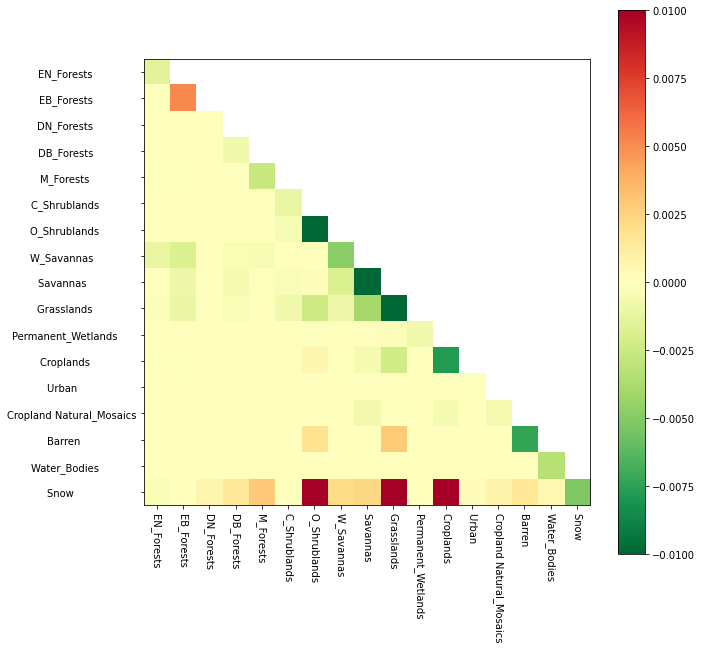

In [30]:
dif_al_tranf=np.nansum(dif_al.reshape(-1,18,18),axis=0)
dif_al_tranf=dif_al_tranf/365/24/3600/5.1e8/1e6
dif_al_tranf=np.delete(dif_al_tranf,14,axis=0)
dif_al_tranf=np.delete(dif_al_tranf,14,axis=1)


dif_al_tranf2=np.zeros((17,17))
for x in range(17):
    for y in range(17):
        dif_al_tranf2[x,y]=(dif_al_tranf[y,x]+dif_al_tranf[x,y])
        dif_al_tranf2[y,x]=np.nan
for i in range(17):
    dif_al_tranf2[i,i]=dif_al_tranf[i,i]

ll=[type_code[i] for i in range(18) if i!=14]


initial_cmap = cm.get_cmap('RdYlGn')
reversed_cmap = initial_cmap.reversed()
#x to y 减去y to x
plt.figure(figsize=(10,10))
plt.imshow(dif_al_tranf2,vmax=0.01,vmin=-0.01,cmap=reversed_cmap)
plt.yticks([i for i in range(17)],ll)
plt.xticks([i for i in range(17)],ll)
plt.xticks(rotation=-90)
plt.colorbar()
plt.show()

In [ ]:
np.nansum(dif_al_tranf2[-3])+np.nansum(dif_al_tranf2[:,-3])-dif_al_tranf2[-3,-3]*2

0.006370125925444621

In [31]:
def to_log(k):
    k=k*1e5
    if np.isnan(k):
        return np.nan
    else:
        if k>=0:
            k=np.log10(k)
            if k<0:
                k=0
            return k
        else:
            k=np.log10(k*(-1))
            if k<0:
                k=0
            return -k
dif_al_tranf3=dif_al_tranf2.copy()
for x in range(17):
    for y in range(17):
        dif_al_tranf3[x,y]=to_log(dif_al_tranf3[x,y])
dif_al_tranf4=dif_al_tranf2.copy()
dif_al_tranf4=np.round(dif_al_tranf4*1e5)
# dif_al_tranf4=dif_al_tranf4.astype(np.int32)


In [32]:
data_m=torch.load('/data/hk/albedo/confuse_matrix/confuse_matrix_2020.pth')
mask_t=np.expand_dims(mask[:,0,:],0).repeat(18,axis=0).transpose((1,3,4,0,2))
data_m[mask_t>=2]=np.nan
data_m=month_fill(data_m,mask_t>=2)
data_y=np.nanmean(data_m,axis=0)
transf=np.nansum(data_y,axis=0)
transf=np.nansum(transf,axis=0)
transf2=transf.copy()
transf22=np.zeros((18,18))
for i in range(18):
    transf22[i,i]=0
for x in range(18):
    for y in range(18):
        transf22[x,y]=(transf2[y,x]-transf2[x,y])
        transf22[y,x]=0
# for i in range(18):
#     transf22[i,i]=transf2[i,i]
transf22[transf22==0]=np.nan
transf3=np.zeros((17,17))
transf3[:14,:14]=transf22[:14,:14]
transf3[14:,:14]=transf22[15:,:14]

transf3[:14,14:]=transf22[:14,15:]
transf3[14:,14:]=transf22[15:,15:]
box_indices=[]
for x in range(17):
    for y in range(17):  
        if transf3[x,y]<0:
          box_indices.append((x,y))  

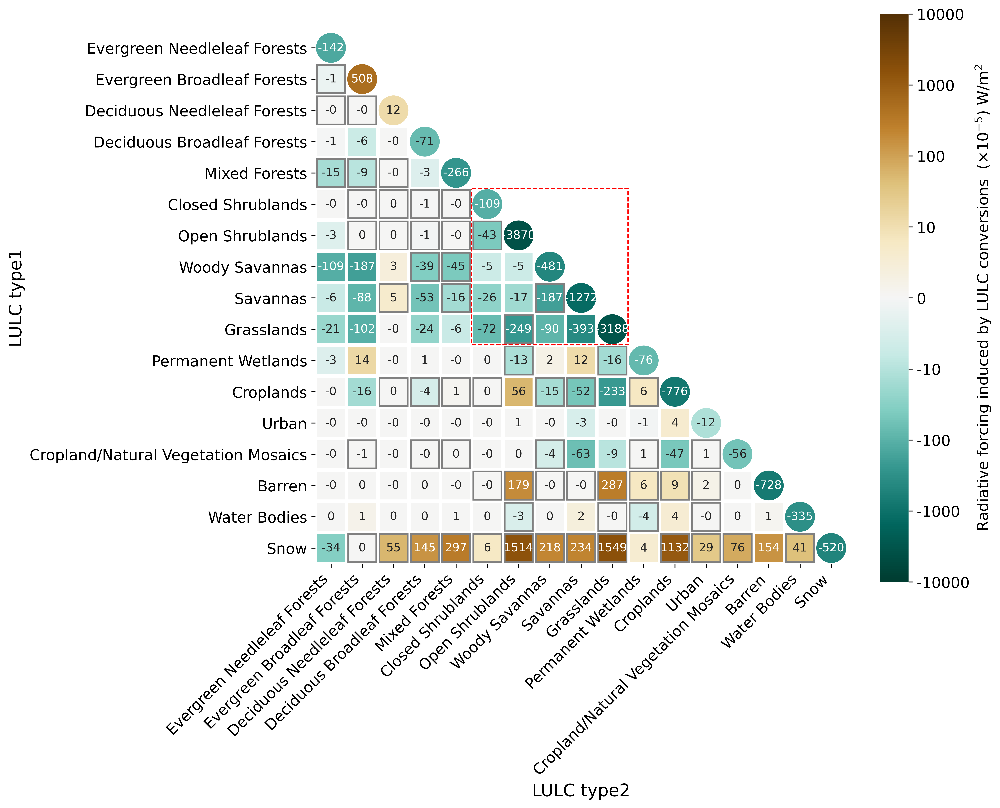

In [36]:
from matplotlib.patches import Circle
from matplotlib.patches import Rectangle
import seaborn as sns
names=['Evergreen Needleleaf Forests',
 'Evergreen Broadleaf Forests',
 'Deciduous Needleleaf Forests',
 'Deciduous Broadleaf Forests',
 'Mixed Forests',
 'Closed Shrublands',
 'Open Shrublands',
 'Woody Savannas',
 'Savannas',
 'Grasslands',
 'Permanent Wetlands',
 'Croplands',
 'Urban',
 'Cropland/Natural Vegetation Mosaics',
 'Barren',
 'Water Bodies',
 'Snow']
def heatmap_with_boxes(data, box_indices, ax=None, **kwargs):
    if not ax:
        ax = plt.gca()
    # ax.imshow(data, **kwargs)

    rows, cols = data.shape

    for i, j in box_indices:
        # 计算框的左下角坐标
        x = j
        y = i

        # 创建框对象并添加到图表中
        rect = Rectangle((x+0.05, y+0.05), 1-0.1, 1-0.1, linewidth=1.5, edgecolor='gray', facecolor='none')
        ax.add_patch(rect)

    ax.set_aspect('equal', adjustable='box')
def heatmap_with_c(data, box_indices, ax=None, **kwargs):
    if not ax:
        ax = plt.gca()
    # ax.imshow(data, **kwargs)

    rows, cols = data.shape
    cmap = plt.get_cmap('BrBG_r')
    norm = plt.Normalize(vmin=-4, vmax=4)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    for i, j in box_indices:
        # 计算框的左下角坐标
        x = j
        y = i


        value = data[x,y]
        color = sm.to_rgba(value)
        # 创建框对象并添加到图表中
        rect = Circle((x+0.5, y+0.5), 0.45, linewidth=1.5, edgecolor=color, facecolor=color)
        rect2 = Rectangle((x+0.05, y+0.05), 1, 1, linewidth=1.5,  facecolor='white')
        ax.add_patch(rect2)
        ax.add_patch(rect)
        

    ax.set_aspect('equal', adjustable='box')
f, ax = plt.subplots(figsize=(12, 10),dpi=600)
sns.heatmap(dif_al_tranf3, ax=ax,vmin=-4,vmax=4,fmt='g',
            annot_kws={"fontsize":10},square=True,cmap='BrBG_r',
            annot=dif_al_tranf4,linewidths=3,cbar=True)

# ax.set_title('Contribution of LULC conversions to global mean albedo') #plt.title('热图'),均可设置图片标题
ax.set_ylabel('LULC type1',fontsize=15)  #设置纵轴标签
ax.set_xlabel('LULC type2',fontsize=15)  #设置横轴标签
plt.yticks([i+0.5 for i in range(17)],names)
plt.xticks([i+0.5 for i in range(17)],names)
plt.yticks(rotation=360, horizontalalignment='right',fontsize=13)
plt.xticks(rotation=45, horizontalalignment='right',fontsize=13)
cbar = ax.collections[0].colorbar
cbar.set_ticks([-4,-3,-2,-1, 0,1,2,3, 4])
cbar.set_ticklabels(['-10000','-1000','-100','-10', '0','10','100','1000', '10000'],fontsize=13)
cbar.set_label(r"Radiative forcing induced by LULC conversions  ($\times 10^{-5}$) W/m$^2$",fontsize=13)

# box_indices = [(2, 2), (3, 3)]

# 在指定位置添加框
heatmap_with_c(dif_al_tranf3, [(i,i) for i in range(17)], ax=ax)
heatmap_with_boxes(dif_al_tranf3, box_indices, ax=ax)

# plt.axhline(y=5, color='r', linestyle='--', linewidth=1)
# plt.axhline(y=10, color='r', linestyle='--', linewidth=1)
# plt.axvline(x=5, color='r', linestyle='--', linewidth=1)
# plt.axvline(x=10, color='r', linestyle='--', linewidth=1)
rect = Rectangle((5, 5), 5, 5, linestyle='--',linewidth=1, edgecolor='r', facecolor='none')
ax.add_patch(rect)
# plt.colorbar(ticks=['10000','1000','100','10','0','-10','-100','-1000','-10000'])
#设置坐标字体方向，通过rotation参数可以调节旋转角度
# label_y = ax.get_yticklabels(names)
# # plt.setp(names, rotation=360, horizontalalignment='right')
# label_x = ax.get_xticklabels(names)
# plt.setp(names, rotation=45, horizontalalignment='right')
plt.tight_layout()
f.savefig('./figure/albedo_RF_kernel_bigfontsize.pdf',dpi=600)
plt.show()

In [ ]:
albedo=torch.load('./albedo_matrix.pth')
RF=torch.load('./RF_matrix.pth')
area=torch.load('./area_matrix.pth')
# 0.0014960914
# -0.07675277252397221w/m2


0.004823371859094665

In [ ]:
5.915444126003422e-05/0.0014957747436673552

0.03954769360191146

In [ ]:
albedo_zero=albedo.copy()
for i in range(17):
    albedo_zero[i,i]=0
RF_zero=RF.copy()
for i in range(17):
    RF_zero[i,i]=0


In [ ]:
(albedo_zero[9,1]+albedo_zero[8,1]+albedo_zero[7,1])

8.040021384658758e-05

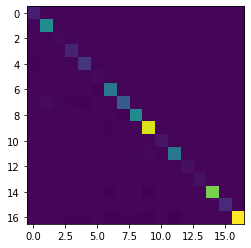

In [ ]:
plt.imshow(area)

In [ ]:
for i in range(17):
    print(i,albedo[i,i],albedo[i,i]/0.0014957747436673552*100,RF[i,i],RF[i,i]/(-0.07675277252397221)*100)

0 4.6688266593264416e-05 3.1213434235955653 -0.0014227581896661106 1.8536896360606914
1 -0.0001252843940164894 -8.375886445930746 0.005082720407078091 -6.622197791604992
2 -5.1885876928281505e-06 -0.346882959135058 0.00011644922400926979 -0.15171989255879867
3 2.148148269043304e-05 1.4361442310333794 -0.0007111958810342821 0.9266061116061366
4 7.01106182532385e-05 4.687244423003198 -0.002658246183829921 3.4633878313642295
5 2.4727711206651293e-05 1.6531707940210065 -0.0010917808263372966 1.4224643494100497
6 0.0009973946725949645 66.6808071748519 -0.03869766406663671 50.41858788169543
7 0.00011603541497606784 7.757546078868203 -0.004810261863530469 6.267215769994601
8 0.00024068757193163037 16.091164324750544 -0.012718078676302197 16.570187965952574
9 0.00077958864858374 52.11938842290764 -0.031883495717588986 41.54051335100736
10 2.5992423616116866e-05 1.7377231248328466 -0.0007641473005963147 0.9955956970253399
11 0.0002538661065045744 16.97221507311609 -0.0077629452968612945 10.1142

In [ ]:
print(albedo_zero[7:9,1].sum())
print(RF_zero[7:9,1].sum())

5.915444126003422e-05
-0.0027456223466676122


In [ ]:
0.0023351090353571635/0.0014957747436673552

1.561136825744176

In [ ]:
albedo.sum()-albedo_zero.sum()-albedo[-2,-2]-albedo[-3,-3]

0.0023351090353571635

In [ ]:
-0.1031982505727234/(-0.07675277252397221)

1.3445540425330105

In [ ]:
RF.sum()-RF_zero.sum()-RF[-2,-2]-RF[-3,-3]

-0.1031982505727234

In [ ]:
RF_zero[12,:-1].sum()+RF_zero[:-1,12].sum()-RF_zero[12,12]*2

2.0564787014909536e-05

In [ ]:
RF[-3,:10].sum()

0.004657455477909525

In [ ]:
RF_zero[-3,:10].sum()

0.004657455477909525

In [ ]:
'''
对比Ghimire和IPCC（CMIP5/6模拟） 1700-2005或者1750-2019土地变化都导致0.15w/m2
大概-0.00049 w/m2/year

'''
#除雪之外的土地转换-草原到草地5种类别的类内转换-森林间的转换+湿地和水体的转换-农田/自然混合类型和农田的转换-裸土相关转换
all=-0.0171195344778834+0.010872907442790845+0.00034958612726890444+4.1229797907037555e-05+0.0004747767470713228-0.004657455477909525
print(all)
print(all/19)

-0.010038489840754814
-0.0005283415705660429


In [ ]:
torch.save(dif_al_tranf2,'./albedo_matrix.pth')

In [ ]:
dif_al_tranf_use=dif_al_tranf2.copy()
dif_al_tranf_use[np.isnan(dif_al_tranf_use)]=0
dif_al_tranf_use.sum()

-0.07675277252397178

In [ ]:
dif_al_tranf_use[:-1,:-1].sum()

-0.12574560560673484

In [ ]:
list(range(1,18))[0:5]

[1, 2, 3, 4, 5]

In [ ]:
for i in range(17):
    dif_al_tranf_use[i,i]=0

In [ ]:
dif_al_tranf_use[-3,:].sum()+dif_al_tranf_use[:,-3].sum()

0.006370125925444621

In [ ]:
RF[-3,:].sum()-RF[-3,-3]

0.004823371859094665

In [ ]:
'''
对比Ghimire和IPCC（CMIP5/6模拟） 1700-2005或者1750-2019土地变化都导致0.15w/m2
大概-0.00049 w/m2/year

'''
#除雪之外的土地转换-草原到草地5种类别的类内转换-森林间的转换+湿地和水体的转换-农田/自然混合类型和农田的转换-裸土相关转换
all=-0.0171195344778834+0.010872907442790845+0.00034958612726890444+4.1229797907037555e-05+0.0004747767470713228-0.006370125925444621
print(all)
print(all/19)

-0.01175116028828991
-0.000618482120436311


In [ ]:
dif_al_tranf_use

In [ ]:
0.010872907442790845/-0.07675277252397221

-0.14166142909554058

In [ ]:
from tool import *
'''
对比NC 2001-2018城市扩张导致0.00017w/m2
'''
kka=np.load('/data/hk/albedo/rf_confuse_matrix_kernel.npy')
# # kka=kka2
kka[np.isnan(kka)]=0
dif_al=kka[:,2018-2001]
dif_al=dif_al.transpose((0,3,4,1,2))
print('type          add         sub               all')
temp=0
temp2=0
all=np.nansum(dif_al)
t=12

print('no snow')
nc=np.nansum(dif_al[:,:,:,t,t])
sub=np.nansum(dif_al[:,:,:,t,-1])-nc
add=np.nansum(dif_al[:,:,:,:-1,t])-nc
print(type_code[t],'     ',
    # to_str(nc/365/24/3600/5.1e8/1e6,k=7,l=10),'     ',
    to_str(add/365/24/3600/5.1e8/1e6,k=7,l=10),'     ',
    to_str(sub/365/24/3600/5.1e8/1e6,k=7,l=10),'     ',
    to_str(((sub+add))/365/24/3600/5.1e8/1e6,k=7,l=10),'     ',)
temp2+=(sub+add)
    # if t==17:
print('have snow')
nc=np.nansum(dif_al[:,:,:,t,t])
sub=np.nansum(dif_al[:,:,:,t])-nc
add=np.nansum(dif_al[:,:,:,:,t])-nc
print(type_code[t],'     ',
    # to_str(nc/365/24/3600/5.1e8/1e6,k=7,l=10),'     ',
    to_str(add/365/24/3600/5.1e8/1e6,k=7,l=10),'     ',
    to_str(sub/365/24/3600/5.1e8/1e6,k=7,l=10),'     ',
    to_str(((sub+add))/365/24/3600/5.1e8/1e6,k=7,l=10),'     ',)
temp2+=(sub+add)


type          add         sub               all
no snow
Urban                          3.8e-06          2.83e-05         3.21e-05        
have snow
Urban                          0.0003138        -0.0001942       0.0001196       
